In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from skimage import io, img_as_float, transform
from google.colab import drive
from skimage.metrics import mean_squared_error as mse
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import StepLR
import tensorflow as tf
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.model_selection import ParameterGrid
from skimage.metrics import mean_squared_error as mse

Calculating the RMSE

In [ ]:
# calculating the RMSE
def rmse(original, denoised):
  valid_mask = denoised > 0
  return np.sqrt(mse(original[valid_mask], denoised[valid_mask]))


Load Test images we will ultimately be using

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
officialTestImages = '/content/drive/My Drive/Colab Notebooks/stereo_test_set/'
# load images
displayLeft = [os.path.join(officialTestImages, f'lowlight_left_{str(i).zfill(1)}.png') for i in range(0, 5)]
displayRight = [os.path.join(officialTestImages, f'lowlight_right_{str(i).zfill(1)}.png') for i in range(0, 5)]
disparity = [os.path.join(officialTestImages, f'disparity_{str(i).zfill(1)}.png') for i in range(0, 5)]

displayLeftList = [img_as_float(io.imread(img)) for img in displayLeft]
displayRightList = [img_as_float(io.imread(img)) for img in displayRight]
disparityList = [img_as_float(io.imread(img)) for img in disparity]

print(f'Loaded {len(displayLeftList)} noisy images and {len(displayRightList)} clean images. disparity: {len(disparityList)}')

Loaded 5 noisy images and 5 clean images. disparity: 5


Load training set images we will use mainly

In [ ]:
def read_pfm(file):
    with open(file, 'rb') as f:
        header = f.readline().decode('latin-1').rstrip()
        color = header == 'PF'
        if not (header == 'PF' or header == 'Pf'):
            raise ValueError('Not a PFM file.')

        dimensions = f.readline().decode('latin-1').rstrip()
        width, height = map(int, dimensions.split())
        scale = float(f.readline().rstrip())
        endian = '<' if scale < 0 else '>'
        scale = abs(scale)

        data = np.fromfile(f, endian + 'f')
        shape = (height, width, 3) if color else (height, width)

        return np.reshape(data, shape), scale


In [ ]:
trainingTestImages = '/content/drive/My Drive/Colab Notebooks/testingImages/'
trainingDisparityImages = '/content/drive/My Drive/Colab Notebooks/testingDisparity/'
# load images
trainingDisplayLeft = [os.path.join(trainingTestImages, f'lowlight_left_{str(i).zfill(1)}.png') for i in range(0, 5)]
trainingDisplayRight = [os.path.join(trainingTestImages, f'lowlight_right_{str(i).zfill(1)}.png') for i in range(0, 5)]
trainingDisparity = [os.path.join(trainingDisparityImages, f'disparity_{str(i).zfill(1)}.pfm') for i in range(0, 5)]

trainingDisplayLeftList = [img_as_float(io.imread(img)) for img in trainingDisplayLeft]
trainingDisplayRightList = [img_as_float(io.imread(img)) for img in trainingDisplayRight]
trainingDisparityList = [img_as_float(io.imread(img)) for img in trainingDisparity]

print(f'Loaded {len(trainingDisplayLeftList)} noisy images and {len(trainingDisplayRightList)} clean images. disparity: {len(trainingDisparityList)}')

Loaded 5 noisy images and 5 clean images. disparity: 5


In [ ]:
# for disparity_file in trainingDisparity:
#     disparity_map, scale = read_pfm(disparity_file)  # Read the disparity map

#     # Flip the disparity map vertically
#     disparity_map = np.flipud(disparity_map)

#     # Display the corrected disparity map
#     plt.figure(figsize=(10, 5))
#     plt.imshow(disparity_map, cmap='viridis')  # Use a colormap for better visualization
#     plt.title(f"Disparity Map: {disparity_file}")
#     plt.colorbar(label="Disparity Value")
#     plt.axis('off')
#     plt.show()

Create my own low light images

In [ ]:
def create_and_display_lowlight_images_color(input_folder, output_folder, mean_photons_per_pixel=20):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for file in os.listdir(input_folder):
        img_path = os.path.join(input_folder, file)
        clean_image = cv2.imread(img_path)  # Load the image in color (BGR format)

        # Split the image into its Blue, Green, and Red channels
        channels = cv2.split(clean_image)

        noisy_channels = []
        for channel in channels:
            # Normalize the channel and apply Poisson noise
            channel_normalized = channel / channel.mean()
            channel_normalized = channel_normalized * mean_photons_per_pixel

            # Brighter image but more noise
            # channel_noisy = np.random.poisson(channel_normalized).astype(np.float32)

            # Lower light Image but less noise
            channel_noisy = np.random.poisson(channel_normalized).astype(np.uint8)

            # Normalize the noisy channel back to [0, 255] if you're using float32
            # channel_noisy = (channel_noisy / channel_noisy.max()) * 255
            # channel_noisy = np.clip(channel_noisy, 0, 255).astype(np.uint8)
            noisy_channels.append(channel_noisy)

        # Merge the noisy channels back into a color image
        image_lowlight = cv2.merge(noisy_channels)

        # Convert BGR (OpenCV default) to RGB for display with matplotlib
        image_lowlight_rgb = cv2.cvtColor(image_lowlight, cv2.COLOR_BGR2RGB)

        # Display the low-light image using plt.imshow()
        plt.figure()
        plt.imshow(image_lowlight_rgb)
        plt.title(f"Low-light Image: {file}")
        plt.axis('off')  # Turn off axis for better visibility
        plt.show()

        # Save the low-light image to the output folder
        output_path = os.path.join(output_folder, file)
        cv2.imwrite(output_path, image_lowlight)

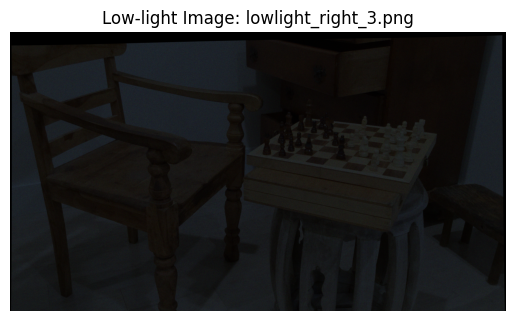

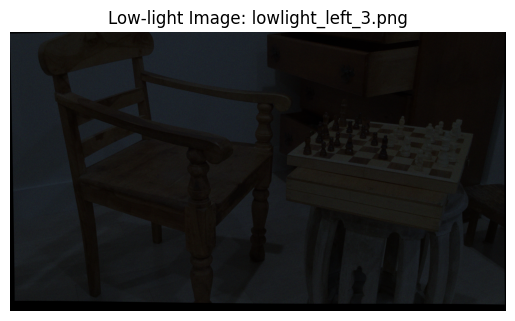

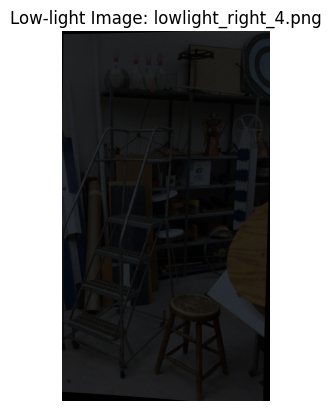

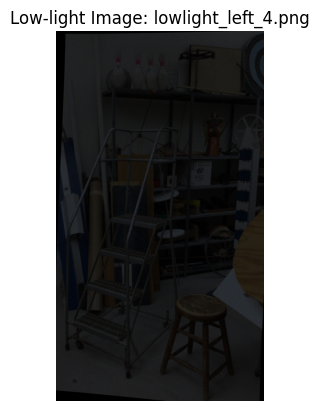

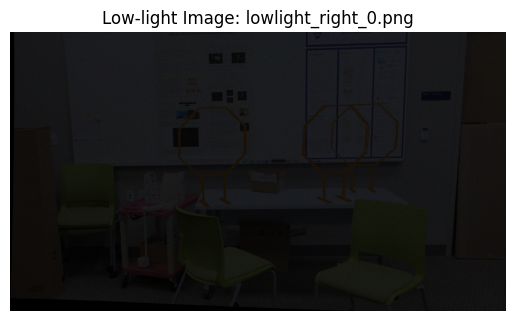

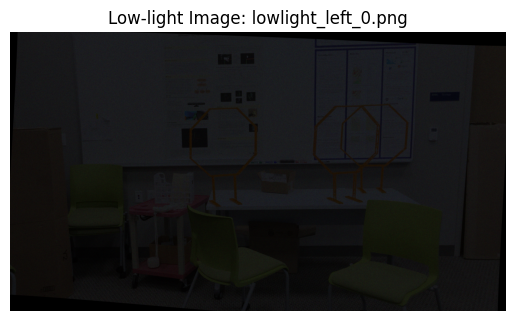

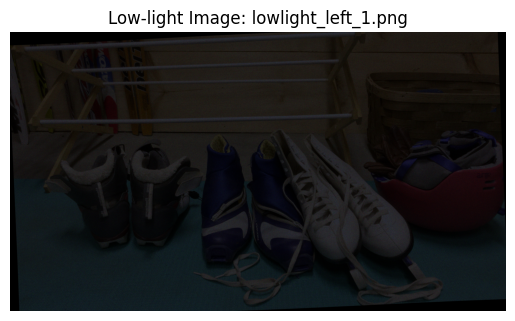

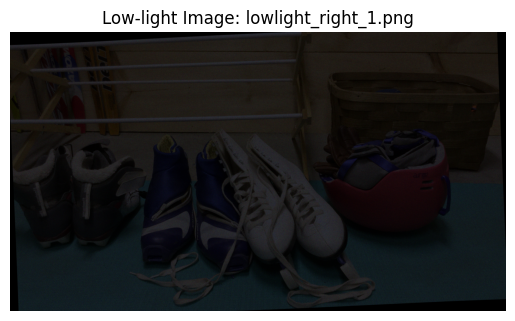

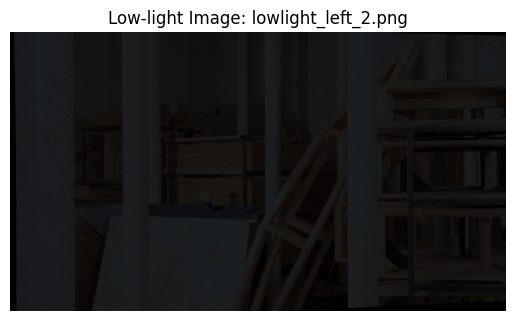

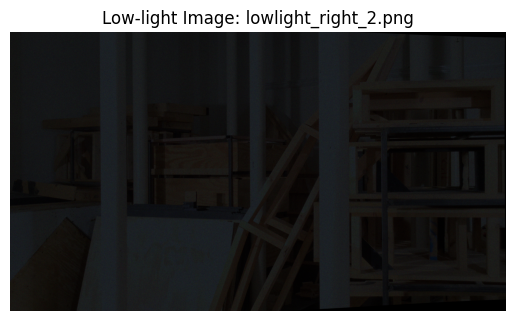

In [ ]:
output_folder = '/content/drive/My Drive/Colab Notebooks/output_folder/'

create_and_display_lowlight_images_color(trainingTestImages, output_folder)

Load the lowlight images

In [ ]:
lowlightImagesTest = '/content/drive/My Drive/Colab Notebooks/output_folder/'
lowlightDisparityTest = '/content/drive/My Drive/Colab Notebooks/testingDisparity/'
# load images
lowlightDisplayLeft = [os.path.join(lowlightImagesTest, f'lowlight_left_{str(i).zfill(1)}.png') for i in range(0, 5)]
lowlightDisplayRight = [os.path.join(lowlightImagesTest, f'lowlight_right_{str(i).zfill(1)}.png') for i in range(0, 5)]
lowlightDisparity = [os.path.join(lowlightImagesTest, f'disparity_{str(i).zfill(1)}.pfm') for i in range(0, 5)]

lowlightDisplayLeftList = [img_as_float(io.imread(img)) for img in lowlightDisplayLeft]
lowlightDisplayRightList = [img_as_float(io.imread(img)) for img in lowlightDisplayRight]
lowlightDisparityList = [img_as_float(io.imread(img)) for img in lowlightDisparity]

print(f'Loaded {len(lowlightDisplayLeftList)} noisy images and {len(lowlightDisplayRightList)} clean images. disparity: {len(lowlightDisparityList)}')

Loaded 5 noisy images and 5 clean images. disparity: 5


3D Scene Reconstructing using feature matching

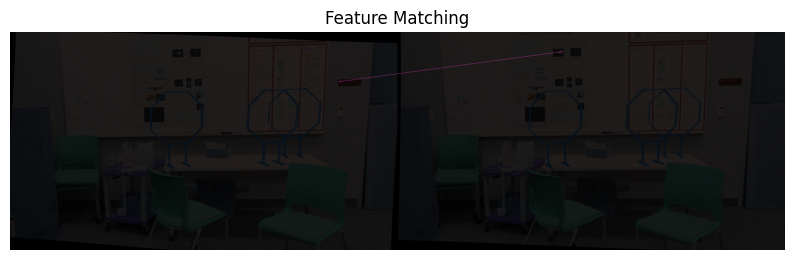

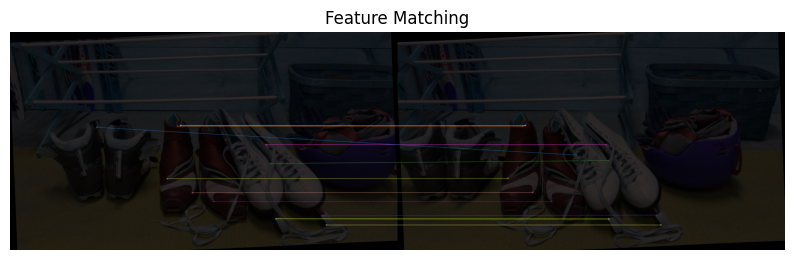

No descriptors found in one of the images. Skipping this pair...


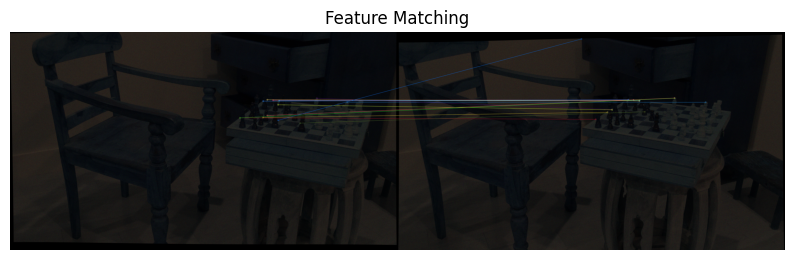

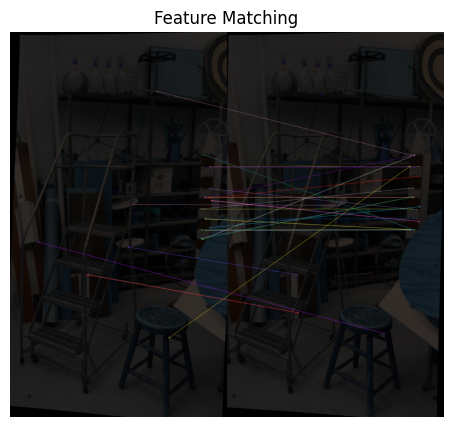

In [ ]:
# Iterate through the left and right image lists
for left_image, right_image in zip(lowlightDisplayLeftList, lowlightDisplayRightList):
    # Convert images to 8-bit (required for most OpenCV functions)
    left_8bit = (left_image * 255).astype(np.uint8)
    right_8bit = (right_image * 255).astype(np.uint8)

    # Convert to grayscale if not already
    if len(left_8bit.shape) == 3:  # Check if image is color
        left_gray = cv2.cvtColor(left_8bit, cv2.COLOR_RGB2GRAY)
        right_gray = cv2.cvtColor(right_8bit, cv2.COLOR_RGB2GRAY)
    else:
        left_gray = left_8bit
        right_gray = right_8bit

    # Initialize the ORB detector
    orb = cv2.ORB_create()

    # Detect and compute keypoints and descriptors
    keypoints_left, descriptors_left = orb.detectAndCompute(left_gray, None)
    keypoints_right, descriptors_right = orb.detectAndCompute(right_gray, None)

    if descriptors_left is None or descriptors_right is None:
      print("No descriptors found in one of the images. Skipping this pair...")
      continue

    # print(descriptors_left.dtype, descriptors_right.dtype)

    # Match features using the Brute-Force Matcher
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors_left, descriptors_right)

    # Sort matches based on distance
    matches = sorted(matches, key=lambda x: x.distance)

    # Visualize the matches
    matched_image = cv2.drawMatches(
        left_8bit, keypoints_left, right_8bit, keypoints_right, matches[:50], None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    # Display the matched features
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))  # Convert to RGB for plt.imshow
    plt.title('Feature Matching')
    plt.axis('off')
    plt.show()



Creating a class for loading and preprocessing the dataset

In [ ]:
class StereoDataset(Dataset):
    def __init__(self, left_images, right_images, disparities, size=(256, 256)):
        # Resize all images and disparities to a fixed size
        self.left_images = [cv2.resize(img, size, interpolation=cv2.INTER_LINEAR) for img in left_images]
        self.right_images = [cv2.resize(img, size, interpolation=cv2.INTER_LINEAR) for img in right_images]
        self.disparities = [cv2.resize(img, size, interpolation=cv2.INTER_LINEAR) for img in disparities]  # Resize disparities

    def __len__(self):
        return len(self.left_images)

    def __getitem__(self, idx):
        # Load left and right images
        left_image = self.left_images[idx]
        right_image = self.right_images[idx]

        # Load disparity map
        disparity = self.disparities[idx]

        # Convert to tensors
        left_tensor = torch.from_numpy(left_image.transpose(2, 0, 1)).float()
        right_tensor = torch.from_numpy(right_image.transpose(2, 0, 1)).float()
        disparity_tensor = torch.from_numpy(disparity).float()  # Disparity is grayscale, no need to transpose

        return left_tensor, right_tensor, disparity_tensor

dataset = StereoDataset(lowlightDisplayLeftList, lowlightDisplayLeftList, lowlightDisparityList)
dataloader = DataLoader(dataset, batch_size=2, shuffle=True)

Testing StereoBM and StereoRGBM algorithms

In [ ]:
# Function to compute disparity using StereoBM
def compute_disparity_bm(left_image, right_image, params):
    stereo_bm = cv2.StereoBM_create(numDisparities=params['numDisparities'], blockSize=params['blockSize'])
    disparity_bm = stereo_bm.compute(left_image, right_image)
    return disparity_bm

In [ ]:
# Function to compute disparity using StereoSGBM
def compute_disparity_sgbm(left_image, right_image, params):
    stereo_sgbm = cv2.StereoSGBM_create(
        minDisparity=params['minDisparity'],
        numDisparities=params['numDisparities'],
        blockSize=params['blockSize'],
        P1=params['P1'],
        P2=params['P2'],
        mode=cv2.STEREO_SGBM_MODE_SGBM
    )
    disparity_sgbm = stereo_sgbm.compute(left_image, right_image)
    return disparity_sgbm

In [ ]:
def process_multiple_image_pairs(left_images, right_images, method="BM"):
    for idx, (left_image, right_image) in enumerate(zip(left_images, right_images)):
        # Ensure the images are in the valid range [0, 1]
        left_image = np.clip(left_image, 0, 1)
        right_image = np.clip(right_image, 0, 1)

        # Convert images to 8-bit format for OpenCV (required by StereoBM and StereoSGBM)
        left_image_8bit = (left_image * 255).astype(np.uint8)
        right_image_8bit = (right_image * 255).astype(np.uint8)

        # Compute the disparity map based on the selected method
        if method == "BM":
            disparity_map = compute_disparity_bm(left_image_8bit, right_image_8bit)
        elif method == "SGBM":
            disparity_map = compute_disparity_sgbm(left_image_8bit, right_image_8bit)
        else:
            raise ValueError("Unknown method! Use 'BM' or 'SGBM'.")

        # Normalize the disparity map for better visualization
        disparity_map_normalized = cv2.normalize(disparity_map, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

        # Display the disparity map
        plt.figure(figsize=(8, 6))
        plt.imshow(disparity_map_normalized, cmap='gray')
        plt.title(f"Disparity Map for Pair {idx + 1} ({method})")
        plt.colorbar()
        plt.show()

In [ ]:
# Function to perform parameter tuning
def tune_stereo_params(left_images, right_images, ground_truths, method="BM"):
    best_params = None
    best_rmse = float('inf')

    # Define the parameter grid
    if method == "BM":
        param_grid = {
            'numDisparities': [16, 32, 64],  # Must be divisible by 16
            'blockSize': [5, 9, 15, 21]
        }
        compute_disparity = compute_disparity_bm
    elif method == "SGBM":
        param_grid = {
            'minDisparity': [0],  # Fixed to 0
            'numDisparities': [16, 32, 64],
            'blockSize': [5, 7, 11],
            'P1': [8, 16, 24],
            'P2': [32, 64, 96]
        }
        compute_disparity = compute_disparity_sgbm
    else:
        raise ValueError("Unknown method! Use 'BM' or 'SGBM'.")

    # Use ParameterGrid to generate all combinations
    for params in ParameterGrid(param_grid):
        rmses = []
        for left_image, right_image, ground_truth in zip(left_images, right_images, ground_truths):

            left_image = (np.clip(left_image, 0, 1) * 255).astype(np.uint8)
            right_image = (np.clip(right_image, 0, 1) * 255).astype(np.uint8)

            # Convert images to grayscale
            left_gray = cv2.cvtColor(left_image, cv2.COLOR_BGR2GRAY)
            right_gray = cv2.cvtColor(right_image, cv2.COLOR_BGR2GRAY)

            # Compute disparity map
            disparity_map = compute_disparity(left_gray, right_gray, params)

            # Normalize and evaluate RMSE
            disparity_map = disparity_map.astype(np.float32) / 16.0
            ground_truth = ground_truth.astype(np.float32)
            # disparity_map_normalized = cv2.normalize(disparity_map, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
            rmses.append(rmse(disparity_map, ground_truth))

        # Average RMSE for this parameter combination
        avg_rmse = np.mean(rmses)
        print(f"{method} Params: {params}, RMSE: {avg_rmse}")

        # Update the best parameters
        if avg_rmse < best_rmse:
            best_rmse = avg_rmse
            best_params = params

    print(f"Best {method} Params: {best_params}, RMSE: {best_rmse}")
    return best_params

In [ ]:
# image_pairs = list(zip(lowlightDisplayLeftList, lowlightDisplayRightList))

# Process the image pairs using StereoBM
# process_multiple_image_pairs(lowlightDisplayLeftList, lowlightDisplayRightList, method="BM")

# # Process the image pairs using StereoSGBM
# process_multiple_image_pairs(lowlightDisplayLeftList, lowlightDisplayRightList, method="SGBM")

best_bm_params = tune_stereo_params(lowlightDisplayLeftList, lowlightDisplayRightList, lowlightDisparityList, method="BM")
best_sgbm_params = tune_stereo_params(lowlightDisplayLeftList, lowlightDisplayRightList, lowlightDisparityList, method="SGBM")

BM Params: {'blockSize': 5, 'numDisparities': 16}, RMSE: 5.2351437813704935
BM Params: {'blockSize': 5, 'numDisparities': 32}, RMSE: 9.48310787477132
BM Params: {'blockSize': 5, 'numDisparities': 64}, RMSE: 18.397067328918048
BM Params: {'blockSize': 9, 'numDisparities': 16}, RMSE: 3.436429248683956
BM Params: {'blockSize': 9, 'numDisparities': 32}, RMSE: 5.695185719629968
BM Params: {'blockSize': 9, 'numDisparities': 64}, RMSE: 11.98406911625744
BM Params: {'blockSize': 15, 'numDisparities': 16}, RMSE: 2.09368015283746
BM Params: {'blockSize': 15, 'numDisparities': 32}, RMSE: 3.186480413058179
BM Params: {'blockSize': 15, 'numDisparities': 64}, RMSE: 8.908282838165569
BM Params: {'blockSize': 21, 'numDisparities': 16}, RMSE: 1.5534294219129425
BM Params: {'blockSize': 21, 'numDisparities': 32}, RMSE: 2.3857965530866307
BM Params: {'blockSize': 21, 'numDisparities': 64}, RMSE: 8.256145681605936
Best BM Params: {'blockSize': 21, 'numDisparities': 16}, RMSE: 1.5534294219129425
SGBM Param

In [ ]:
# Function to display disparity maps
def display_disparity_maps(left_image, right_image):

    left_image = (np.clip(left_image, 0, 1) * 255).astype(np.uint8)
    right_image = (np.clip(right_image, 0, 1) * 255).astype(np.uint8)

    # Convert input images to grayscale if necessary
    left_gray = cv2.cvtColor(left_image, cv2.COLOR_BGR2GRAY)
    right_gray = cv2.cvtColor(right_image, cv2.COLOR_BGR2GRAY)

    # Compute disparity maps
    stereo_bm = cv2.StereoBM_create(numDisparities=16, blockSize=21)
    stereo_sgbm = cv2.StereoSGBM_create(minDisparity=0, numDisparities=16, blockSize=5, P1=24, P2=32, mode=cv2.STEREO_SGBM_MODE_SGBM)
    disparity_bm = stereo_bm.compute(left_gray, right_gray)
    disparity_sgbm = stereo_sgbm.compute(left_gray, right_gray)

    # Normalize disparity maps for visualization
    disparity_bm_norm = cv2.normalize(disparity_bm, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    disparity_sgbm_norm = cv2.normalize(disparity_sgbm, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # Display the disparity maps
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(disparity_bm_norm, cmap="gray")
    plt.title("StereoBM Disparity Map")
    plt.colorbar()

    plt.subplot(1, 2, 2)
    plt.imshow(disparity_sgbm_norm, cmap="gray")
    plt.title("StereoSGBM Disparity Map")
    plt.colorbar()

    plt.show()

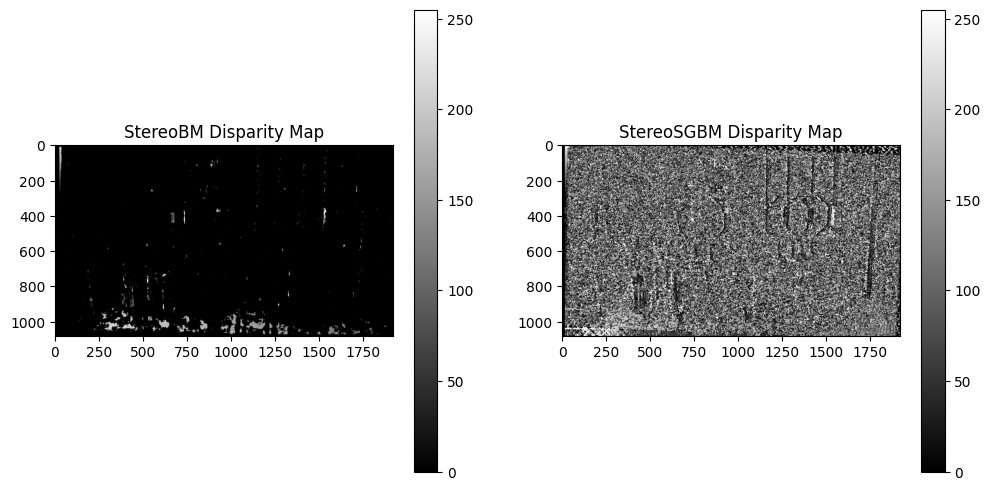

In [ ]:
left_image = lowlightDisplayLeftList[0]  # Replace with appropriate index
right_image = lowlightDisplayRightList[0]  # Replace with appropriate index
display_disparity_maps(left_image, right_image)

Apply everything we learned previously to the official stereo test images. Using the parameters we found to be the best using ParameterGrid.

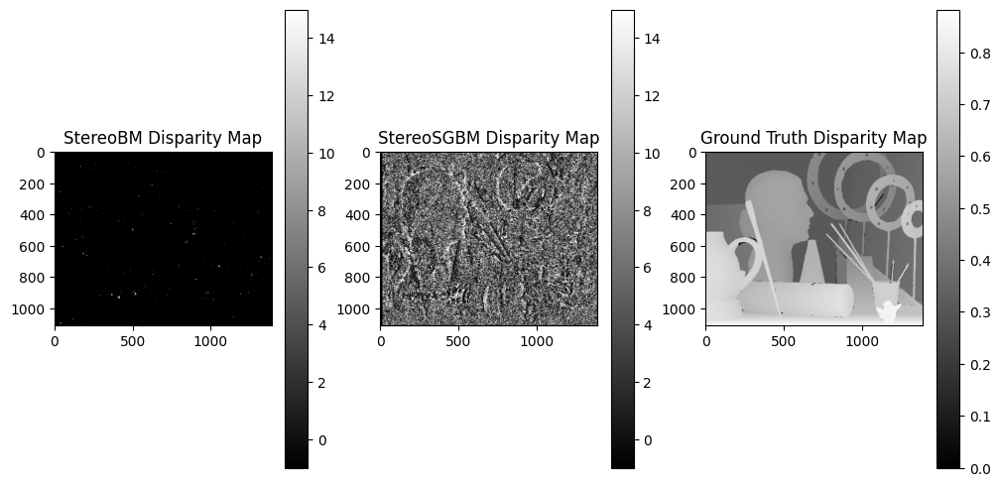

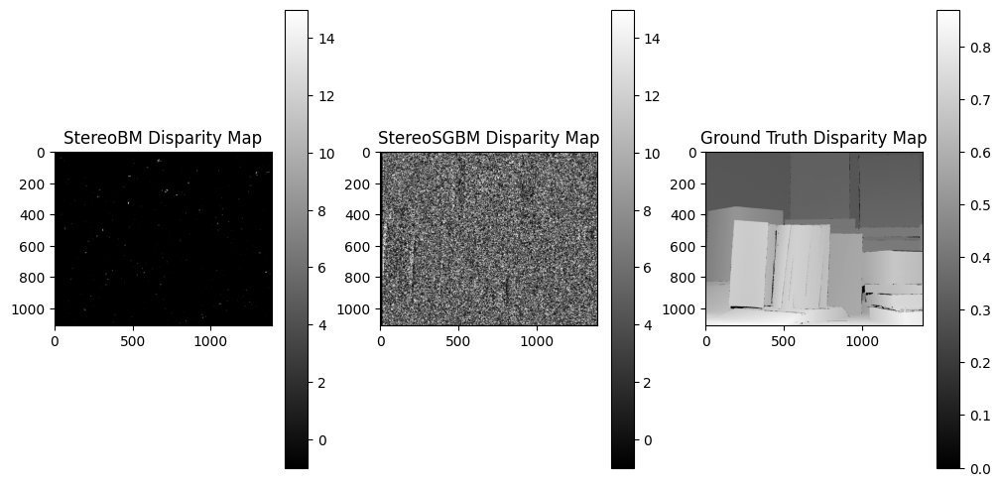

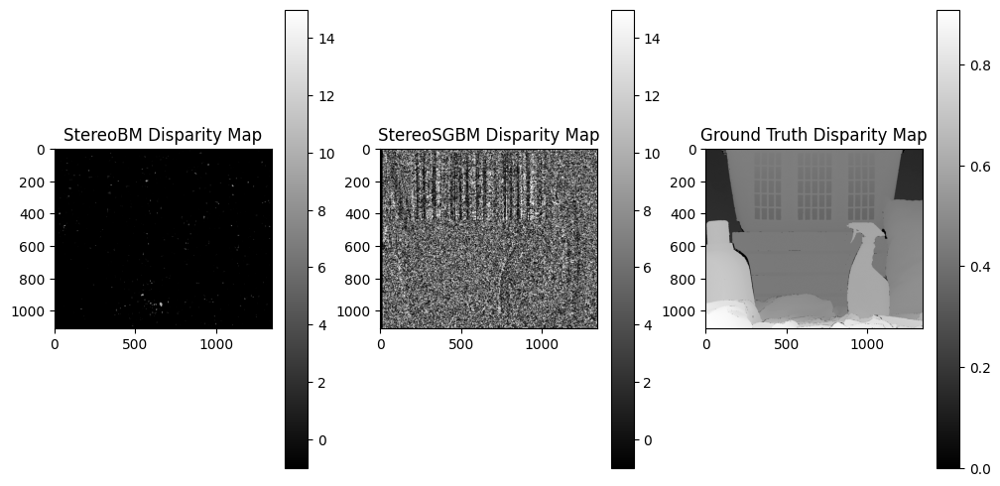

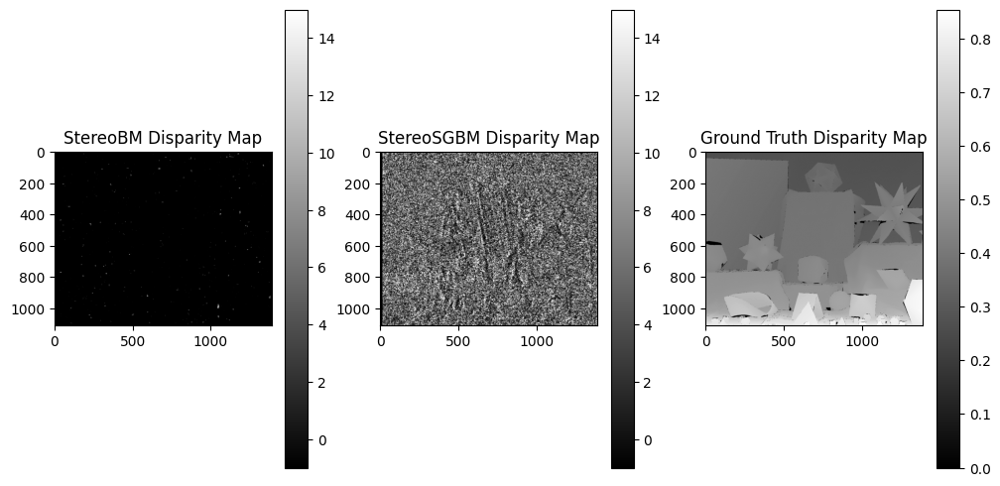

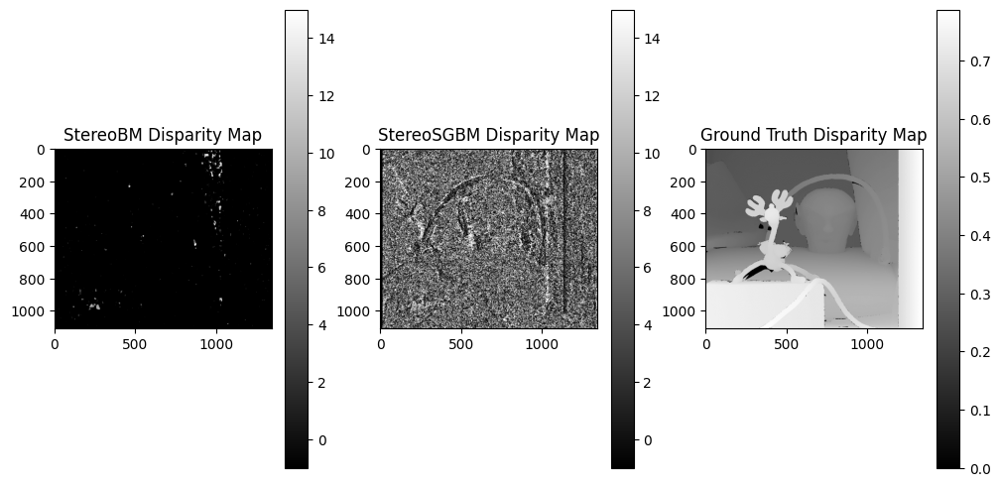

In [ ]:
paramsSGBM = {'minDisparity': 0, 'numDisparities': 16, 'blockSize': 5, 'P1': 24, 'P2': 32}
paramsBM = {'numDisparities': 16, 'blockSize': 21}

rmse_bm = []
rmse_sgbm = []

for left_image, right_image, ground_truth in zip(displayLeftList, displayRightList, disparityList):
    left_image = (np.clip(left_image, 0, 1) * 255).astype(np.uint8)
    right_image = (np.clip(right_image, 0, 1) * 255).astype(np.uint8)

    # Convert images to grayscale
    left_gray = cv2.cvtColor(left_image, cv2.COLOR_BGR2GRAY)
    right_gray = cv2.cvtColor(right_image, cv2.COLOR_BGR2GRAY)

    # Compute disparity maps
    stereo_bm = cv2.StereoBM_create(numDisparities=paramsBM['numDisparities'], blockSize=paramsBM['blockSize'])
    stereo_sgbm = cv2.StereoSGBM_create(
        minDisparity=paramsSGBM['minDisparity'],
        numDisparities=paramsSGBM['numDisparities'],
        blockSize=paramsSGBM['blockSize'],
        P1=paramsSGBM['P1'],
        P2=paramsSGBM['P2'],
        mode=cv2.STEREO_SGBM_MODE_SGBM
    )

    disparity_bm = stereo_bm.compute(left_gray, right_gray)
    disparity_sgbm = stereo_sgbm.compute(left_gray, right_gray)

    # Normalize disparity maps for visualization

    disparity_bm = disparity_bm.astype(np.float32) / 16.0
    disparity_sgbm = disparity_sgbm.astype(np.float32) / 16.0

    ground_truth = ground_truth.astype(np.float32)

    ground_truth = ground_truth[:, :, 0]  # Use the first channel

    ground_truth_resized = cv2.resize(ground_truth, (disparity_bm.shape[1], disparity_bm.shape[0]), interpolation=cv2.INTER_LINEAR)

    # print(f"disparity_bm shape: {disparity_bm.shape}")
    # print(f"disparity_sgbm shape: {disparity_sgbm.shape}")
    # print(f"ground_truth shape: {ground_truth.shape}")

    # rmse_bm.append(rmse(disparity_bm, ground_truth))
    # rmse_sgbm.append(rmse(disparity_sgbm, ground_truth))
    rmse_bm.append(rmse(disparity_bm, ground_truth_resized))
    rmse_sgbm.append(rmse(disparity_sgbm, ground_truth_resized))

    # Display the disparity maps
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(disparity_bm, cmap="gray")
    plt.title(f"StereoBM Disparity Map")
    plt.colorbar()
    plt.subplot(1, 3, 2)
    plt.imshow(disparity_sgbm, cmap="gray")
    plt.title(f"StereoSGBM Disparity Map")
    plt.colorbar()
    plt.subplot(1, 3, 3)
    plt.imshow(ground_truth, cmap="gray")
    plt.title("Ground Truth Disparity Map")
    plt.colorbar()
    plt.show()


In [ ]:
  print(f"Average RMSE for StereoBM: {np.mean(rmse_bm)}")
  print(f"Average RMSE for StereoSGBM: {np.mean(rmse_sgbm)}")

Average RMSE for StereoBM: 1.5866123505459981
Average RMSE for StereoSGBM: 6.887644044474817


Creating my model using PyTorch. StereoCNN

In [ ]:
class StereoCNN(nn.Module):
    def __init__(self):
        super(StereoCNN, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(6, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 1, kernel_size=3, padding=1)
        )

    def forward(self, left, right):
        x = torch.cat((left, right), dim=1)
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Initialize the model
model = StereoCNN()


Predicted Disparity - Min: 0.02786029502749443, Max: 0.07360474765300751


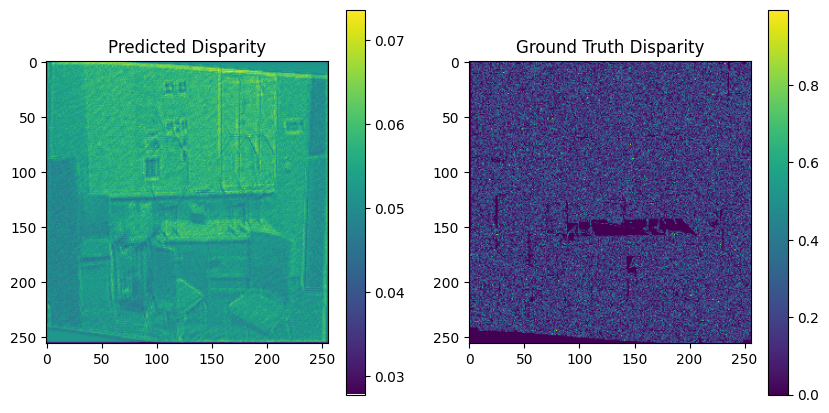

Predicted Disparity - Min: 0.03425709530711174, Max: 0.08616502583026886


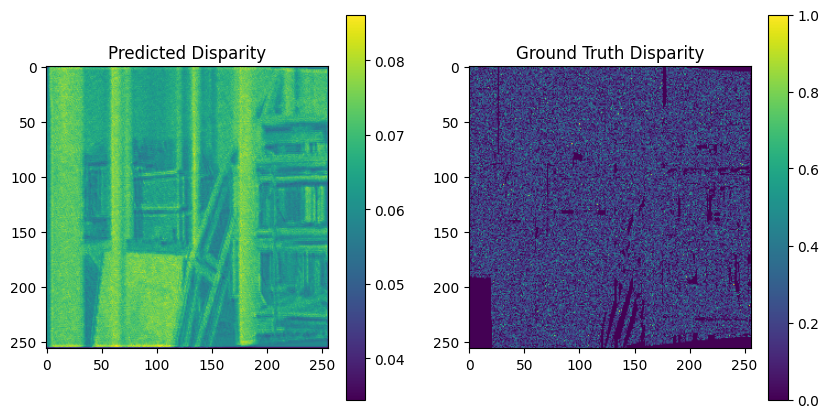

Predicted Disparity - Min: 0.03605806455016136, Max: 0.10822213441133499


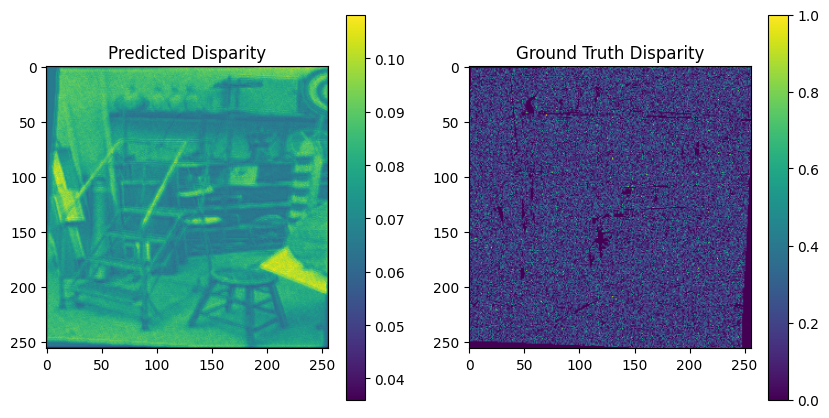

Epoch [1/25], Loss: 0.0124
Predicted Disparity - Min: 0.03793976828455925, Max: 0.12653407454490662


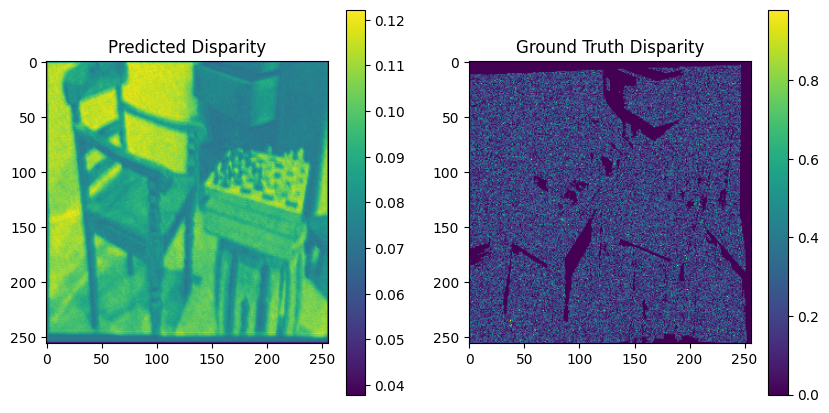

Predicted Disparity - Min: 0.03991404175758362, Max: 0.14627553522586823


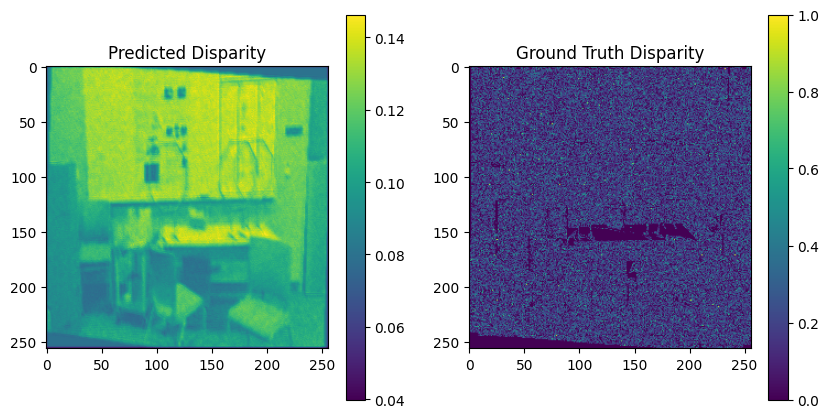

Predicted Disparity - Min: 0.041908565908670425, Max: 0.18260949850082397


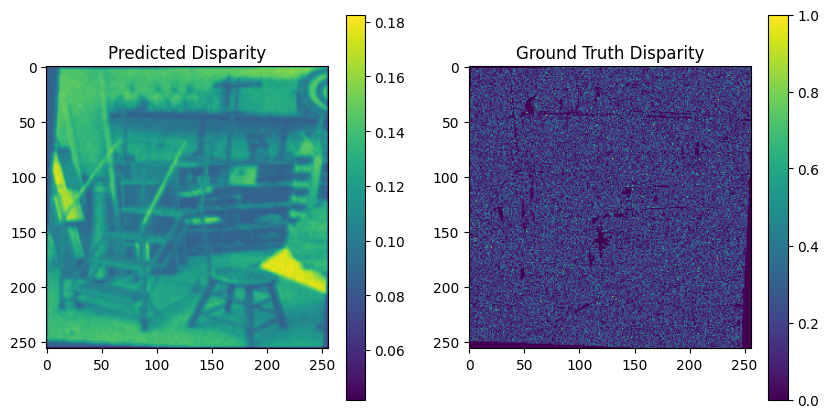

Epoch [2/25], Loss: 0.0095
Predicted Disparity - Min: 0.04383432865142822, Max: 0.1924305558204651


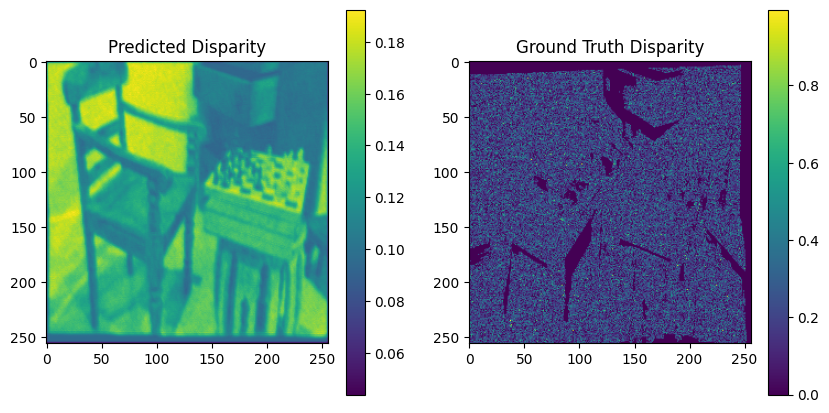

Predicted Disparity - Min: 0.04574767127633095, Max: 0.23830647766590118


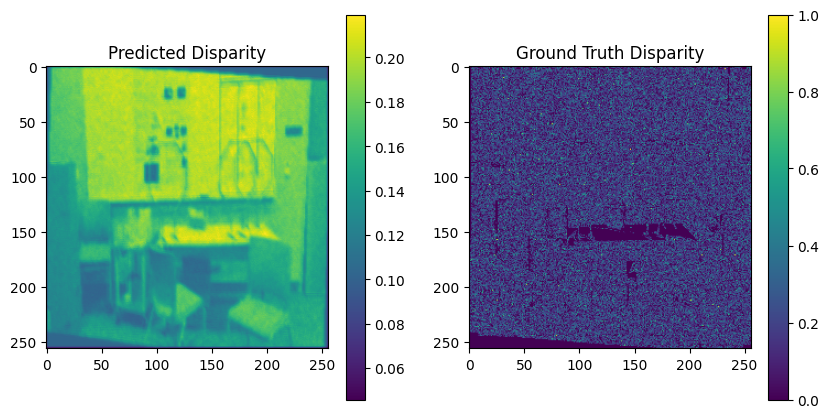

Predicted Disparity - Min: 0.04769568517804146, Max: 0.2553001642227173


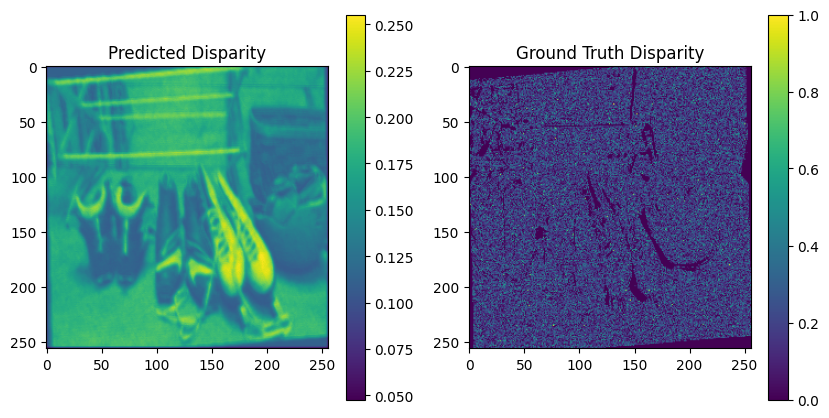

Epoch [3/25], Loss: 0.0084
Predicted Disparity - Min: 0.049649979919195175, Max: 0.2927444279193878


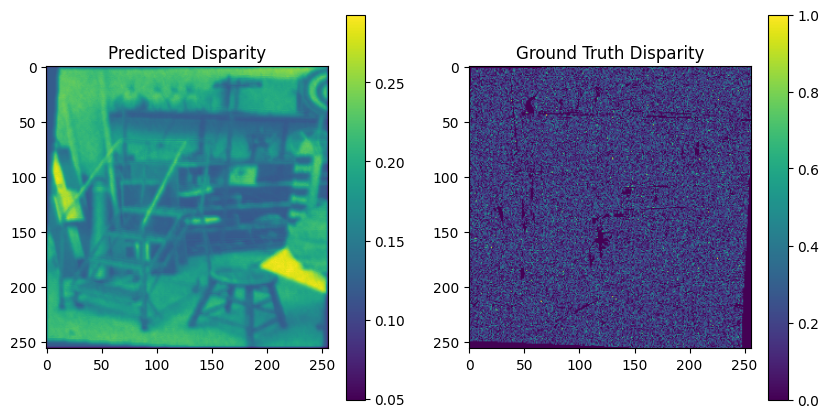

Predicted Disparity - Min: 0.05151906982064247, Max: 0.2881237864494324


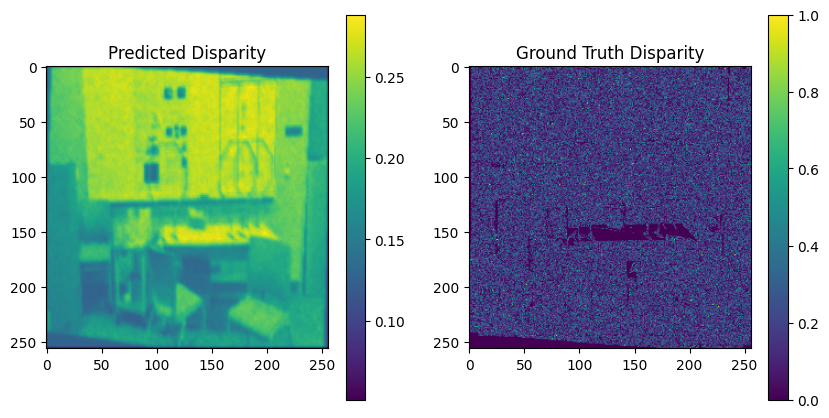

Predicted Disparity - Min: 0.05290476232767105, Max: 0.3094607889652252


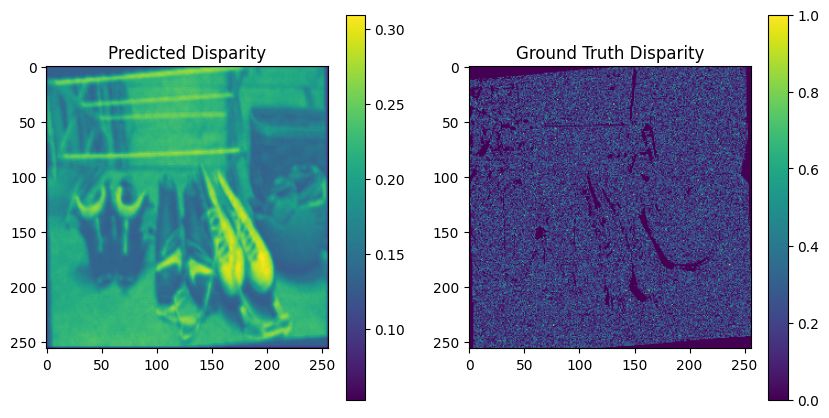

Epoch [4/25], Loss: 0.0088
Predicted Disparity - Min: 0.05392460897564888, Max: 0.3117077350616455


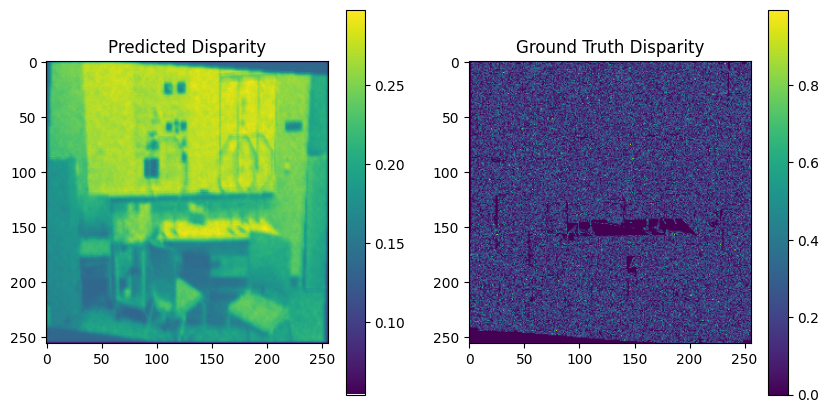

Predicted Disparity - Min: 0.054549746215343475, Max: 0.2918581962585449


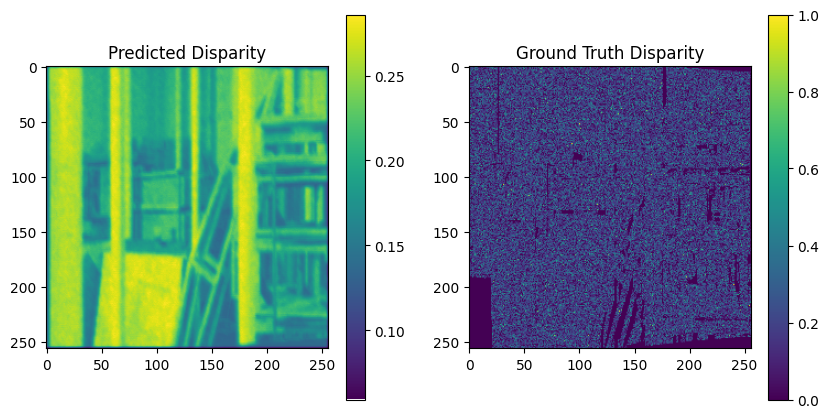

Predicted Disparity - Min: 0.054895564913749695, Max: 0.3097134828567505


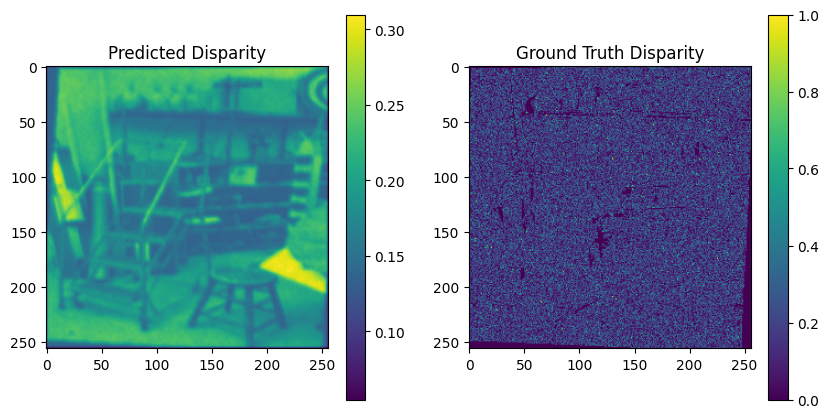

Epoch [5/25], Loss: 0.0083
Predicted Disparity - Min: 0.05516202002763748, Max: 0.2883233428001404


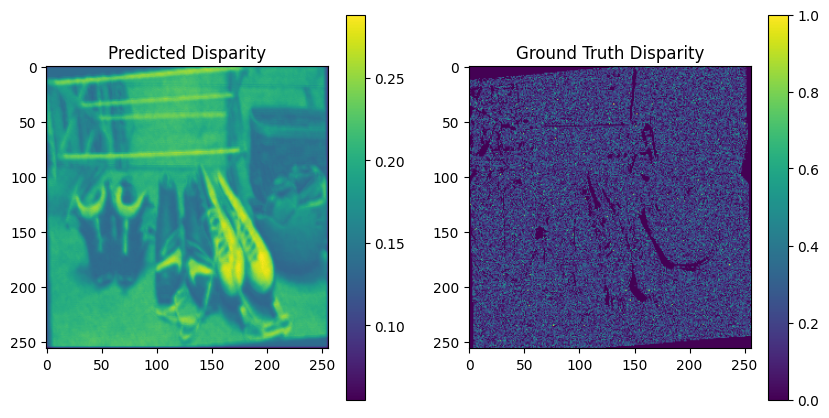

Predicted Disparity - Min: 0.05521612614393234, Max: 0.29413557052612305


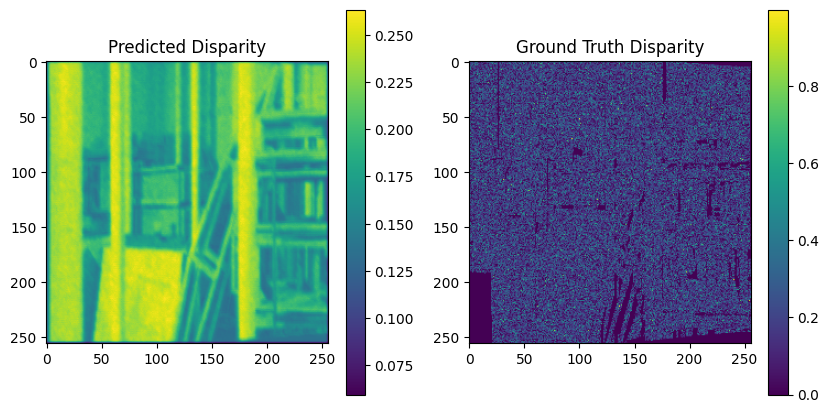

Predicted Disparity - Min: 0.055243123322725296, Max: 0.26537013053894043


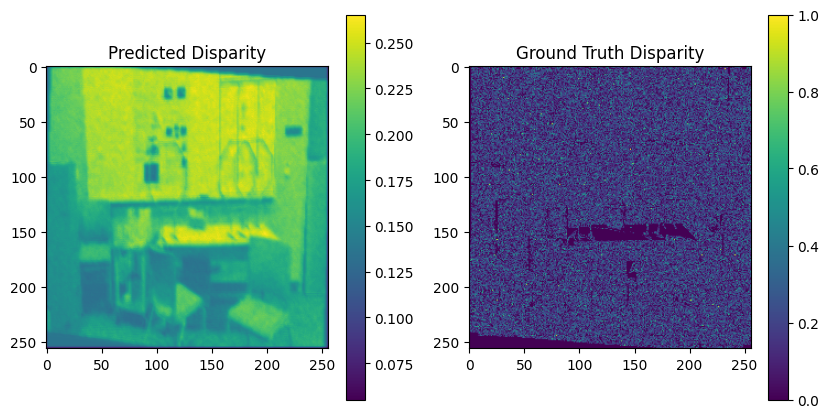

Epoch [6/25], Loss: 0.0085
Predicted Disparity - Min: 0.05519816651940346, Max: 0.2696938216686249


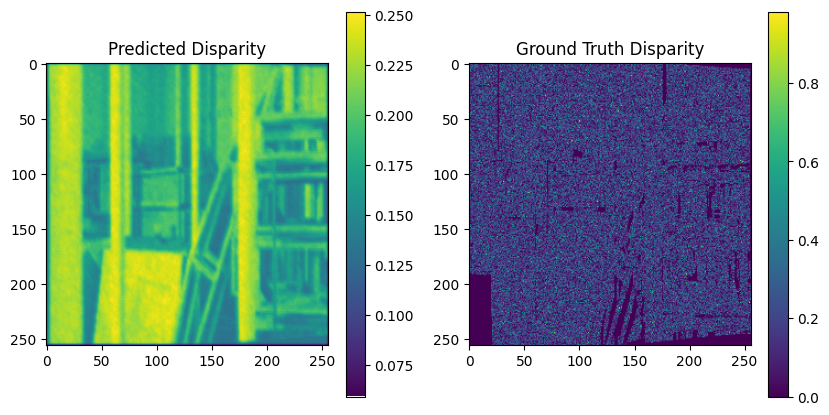

Predicted Disparity - Min: 0.055106472223997116, Max: 0.252645343542099


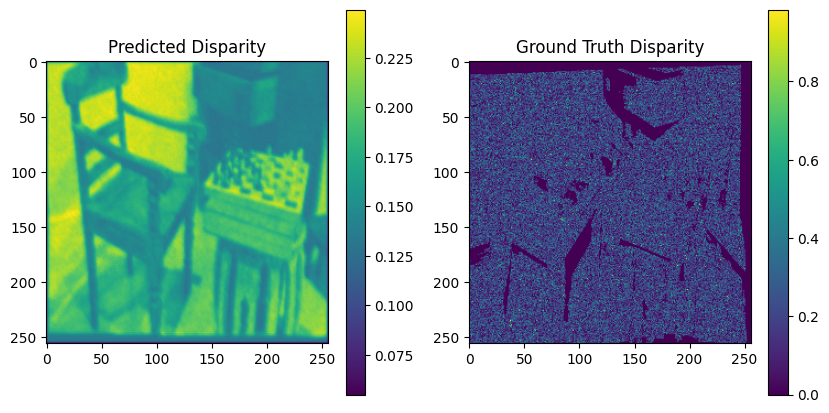

Predicted Disparity - Min: 0.05501213297247887, Max: 0.26645684242248535


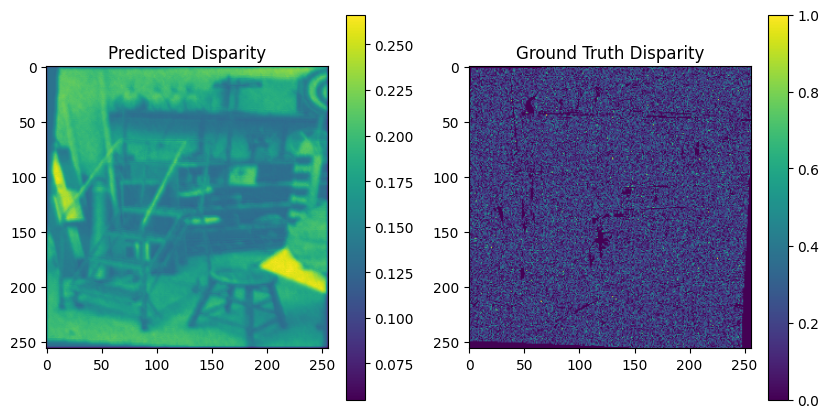

Epoch [7/25], Loss: 0.0080
Predicted Disparity - Min: 0.05498981475830078, Max: 0.25986766815185547


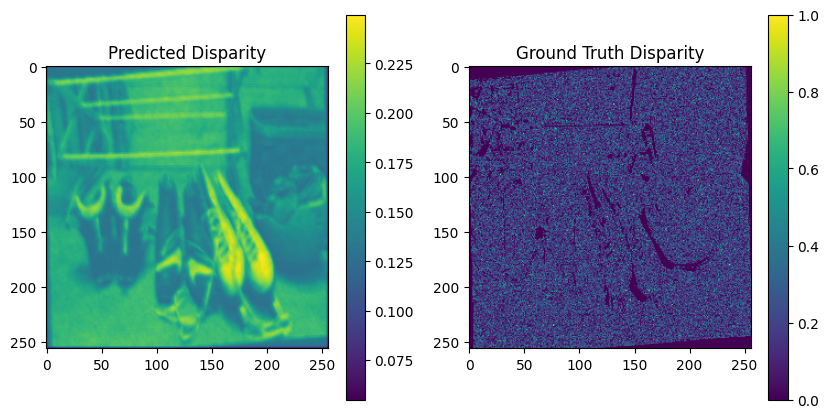

Predicted Disparity - Min: 0.054999057203531265, Max: 0.23510006070137024


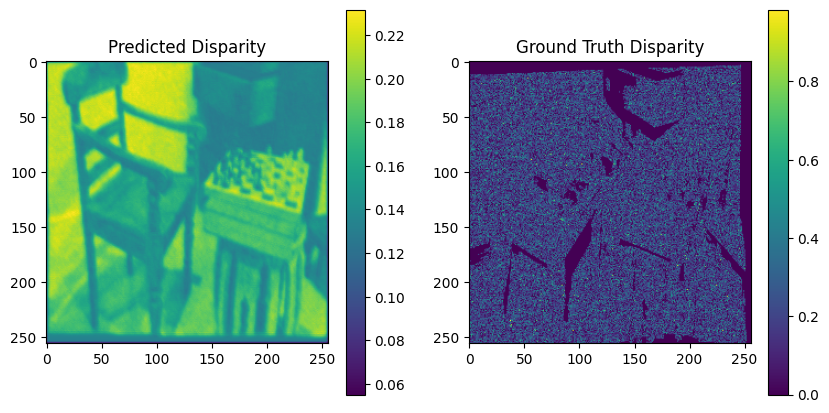

Predicted Disparity - Min: 0.05834614485502243, Max: 0.22353452444076538


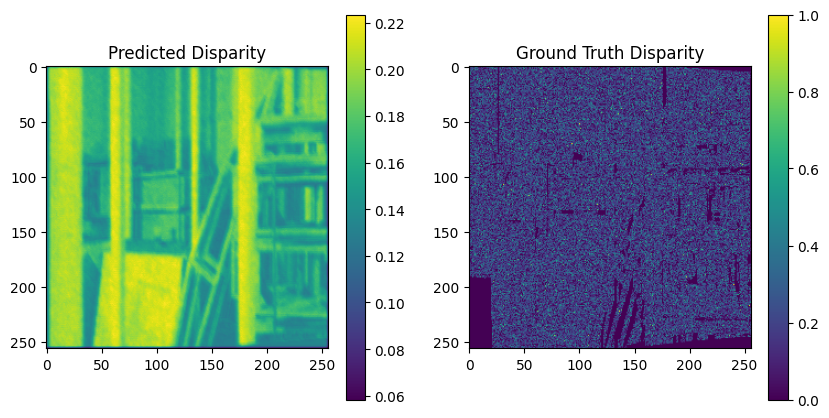

Epoch [8/25], Loss: 0.0085
Predicted Disparity - Min: 0.05504300072789192, Max: 0.24328601360321045


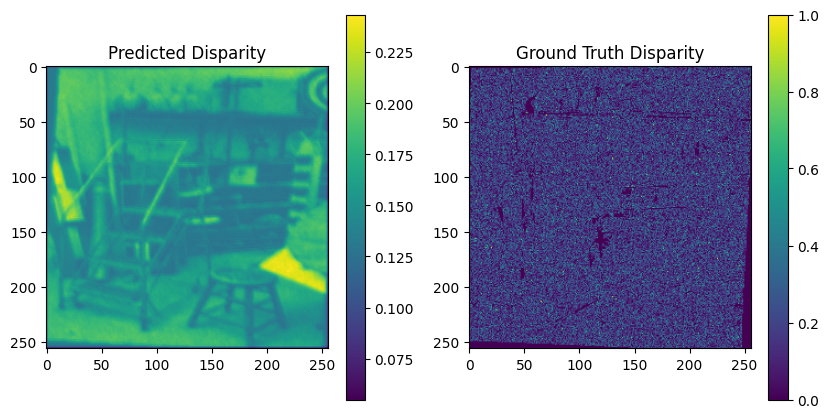

Predicted Disparity - Min: 0.05513298511505127, Max: 0.22185593843460083


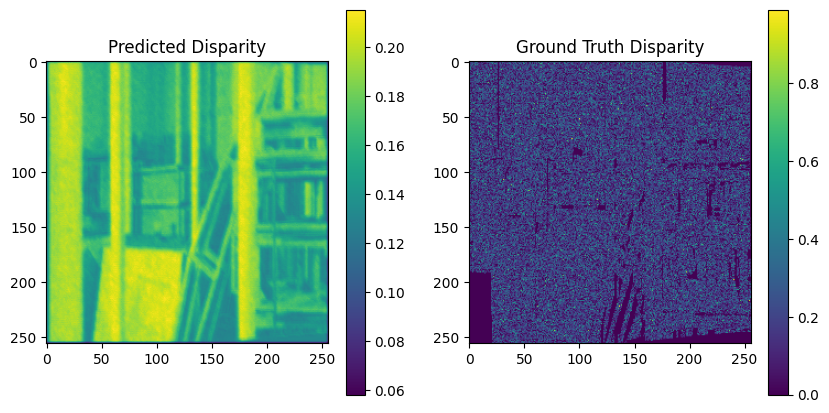

Predicted Disparity - Min: 0.05522489175200462, Max: 0.22633250057697296


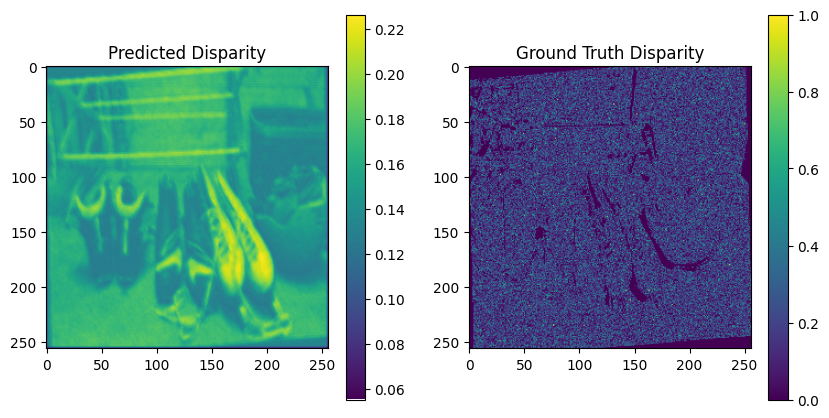

Epoch [9/25], Loss: 0.0083
Predicted Disparity - Min: 0.05534055829048157, Max: 0.21544937789440155


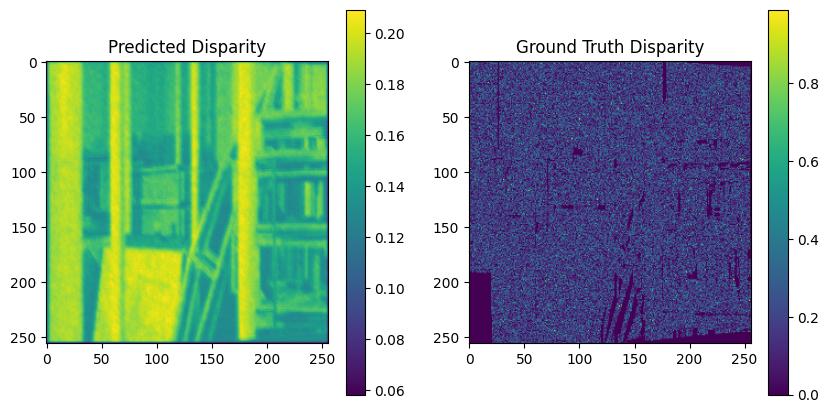

Predicted Disparity - Min: 0.055465664714574814, Max: 0.22058874368667603


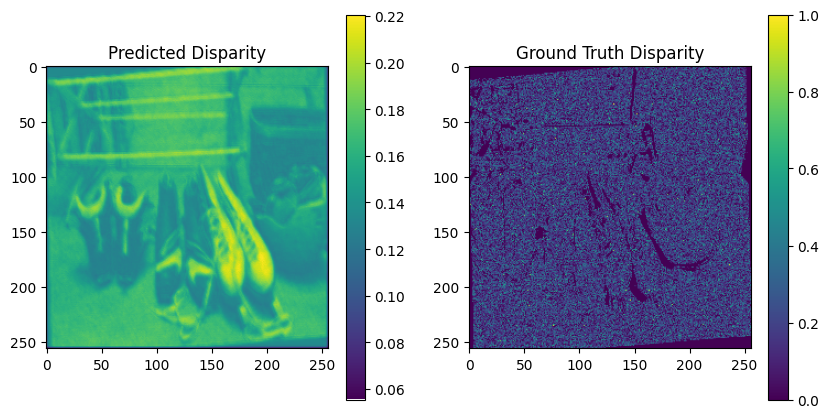

Predicted Disparity - Min: 0.05562623590230942, Max: 0.2262207418680191


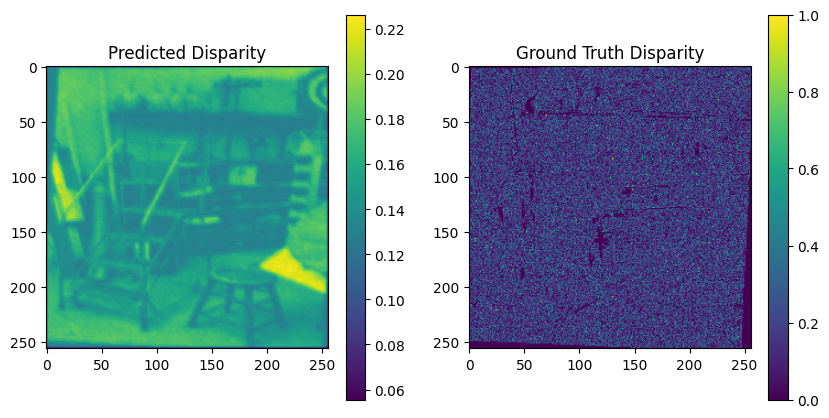

Epoch [10/25], Loss: 0.0080
Predicted Disparity - Min: 0.055870164185762405, Max: 0.21743342280387878


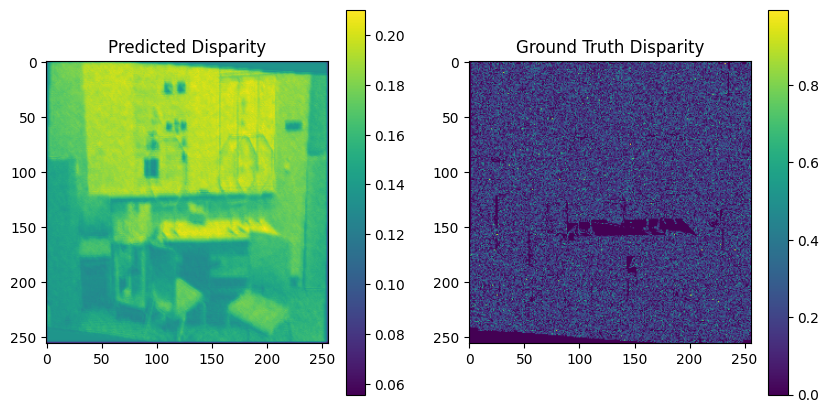

Predicted Disparity - Min: 0.05599693953990936, Max: 0.224294975399971


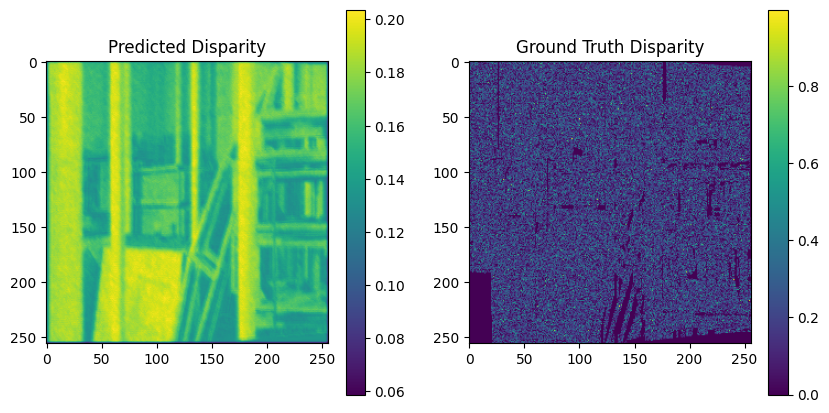

Predicted Disparity - Min: 0.056145697832107544, Max: 0.20632304251194


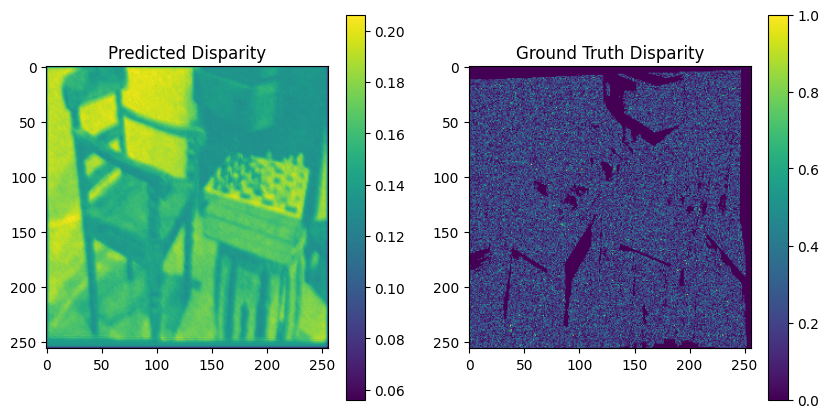

Epoch [11/25], Loss: 0.0095
Predicted Disparity - Min: 0.056315407156944275, Max: 0.22429147362709045


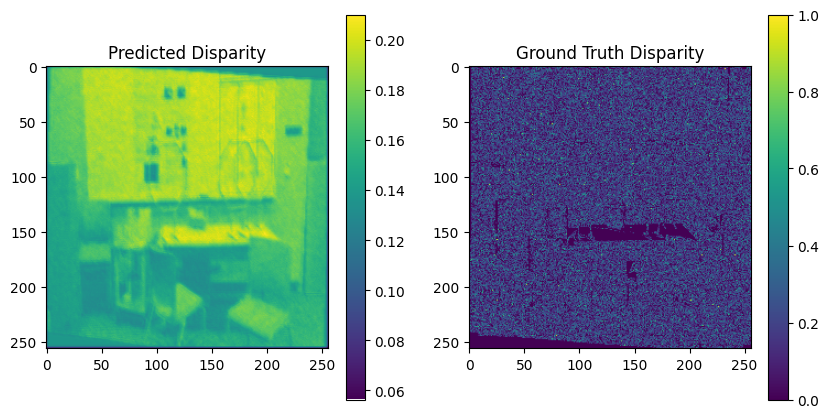

Predicted Disparity - Min: 0.05649828910827637, Max: 0.21733586490154266


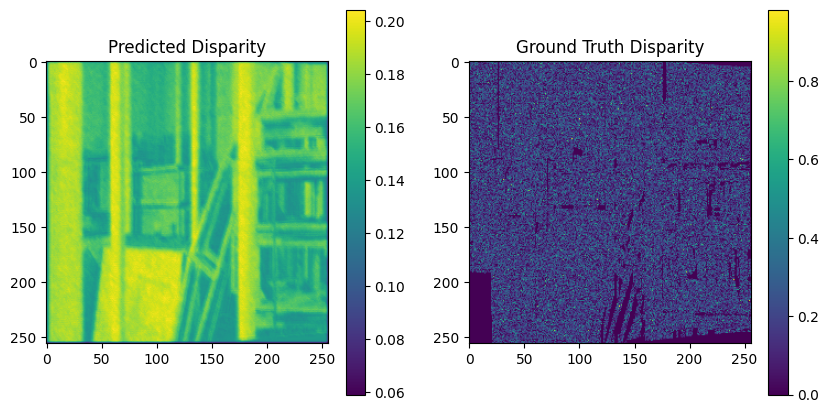

Predicted Disparity - Min: 0.05667416751384735, Max: 0.2074785828590393


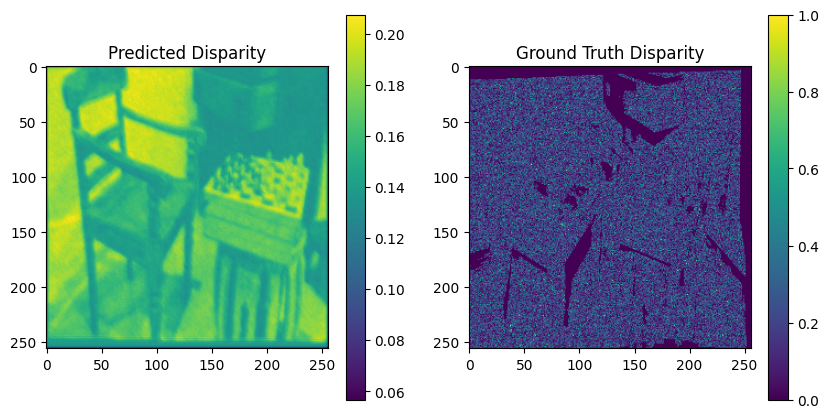

Epoch [12/25], Loss: 0.0095
Predicted Disparity - Min: 0.05686652287840843, Max: 0.21844357252120972


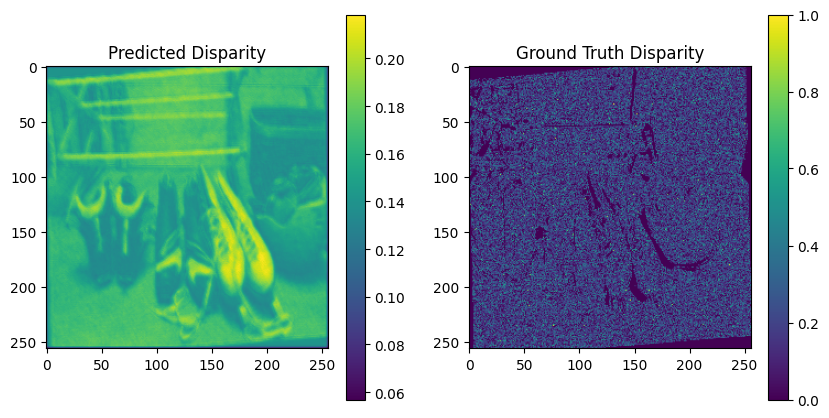

Predicted Disparity - Min: 0.057046931236982346, Max: 0.20915386080741882


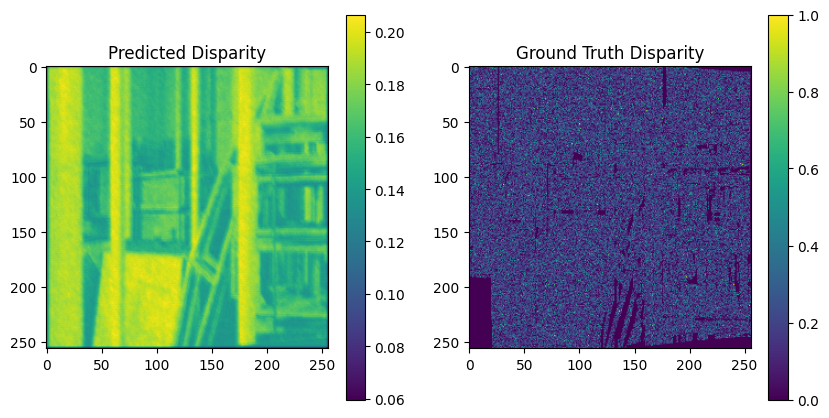

Predicted Disparity - Min: 0.05723034590482712, Max: 0.227080836892128


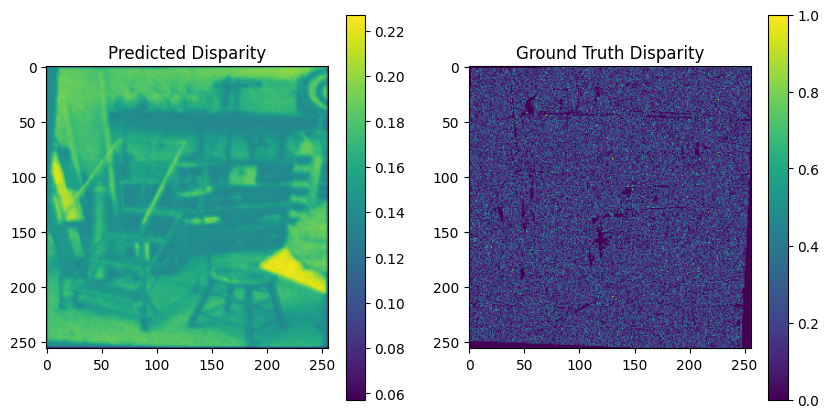

Epoch [13/25], Loss: 0.0079
Predicted Disparity - Min: 0.057441551238298416, Max: 0.22816380858421326


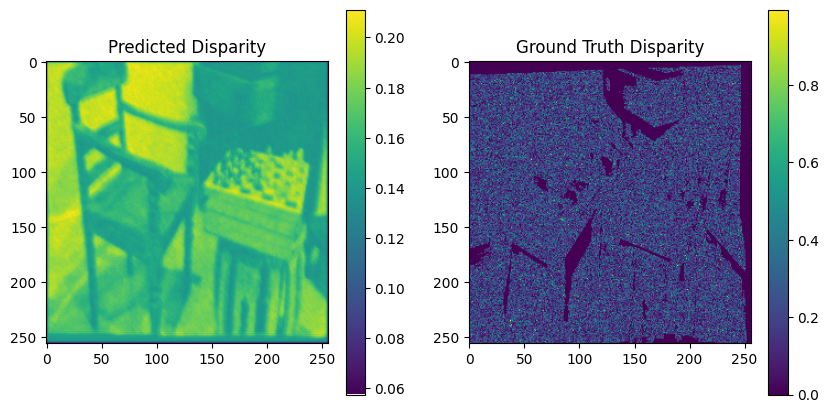

Predicted Disparity - Min: 0.05766821280121803, Max: 0.22232073545455933


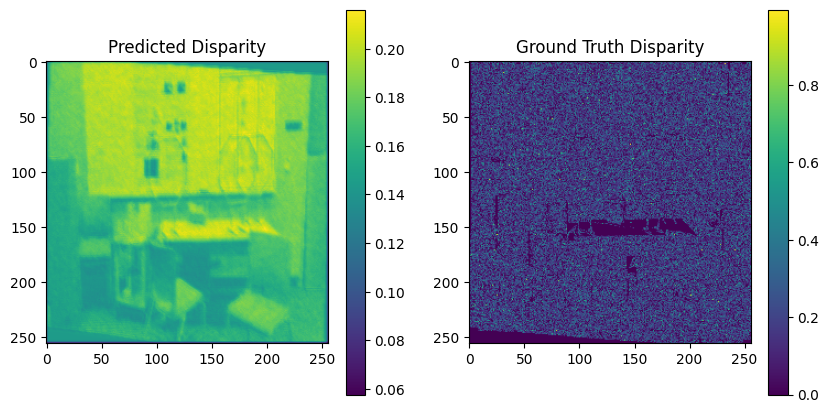

Predicted Disparity - Min: 0.06045714020729065, Max: 0.211027130484581


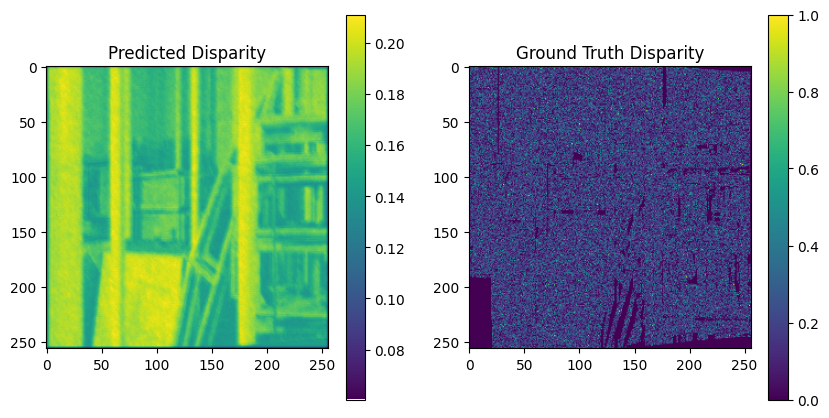

Epoch [14/25], Loss: 0.0083
Predicted Disparity - Min: 0.05805043503642082, Max: 0.21822455525398254


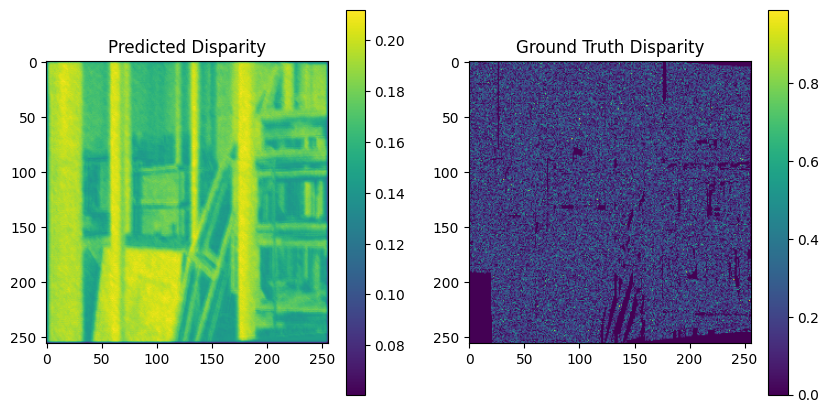

Predicted Disparity - Min: 0.058203261345624924, Max: 0.23181632161140442


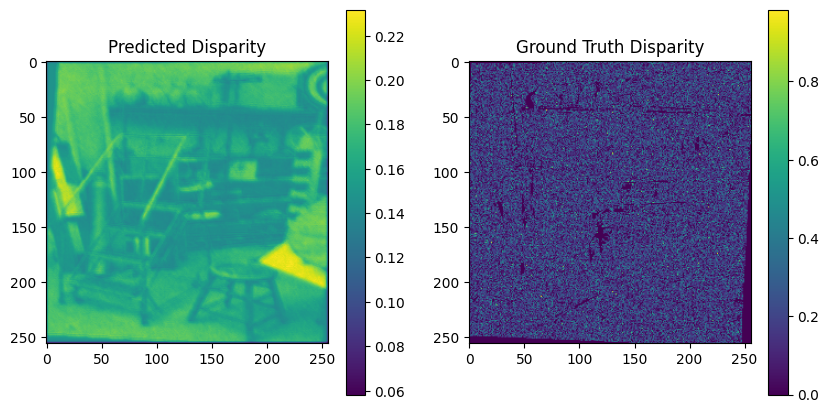

Predicted Disparity - Min: 0.058352090418338776, Max: 0.21606209874153137


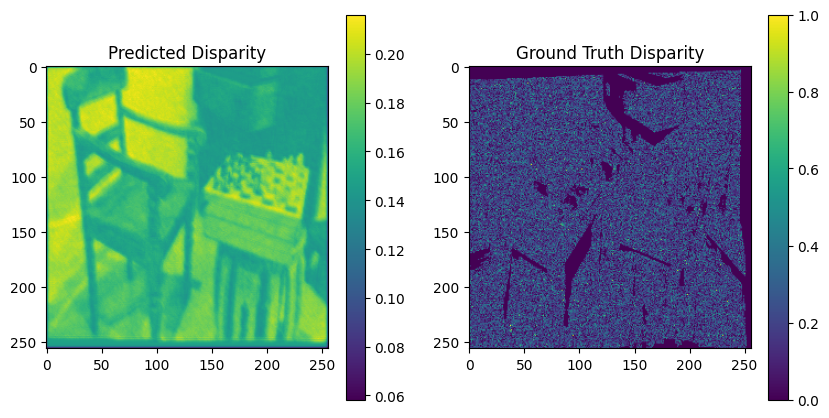

Epoch [15/25], Loss: 0.0094
Predicted Disparity - Min: 0.058506857603788376, Max: 0.22057278454303741


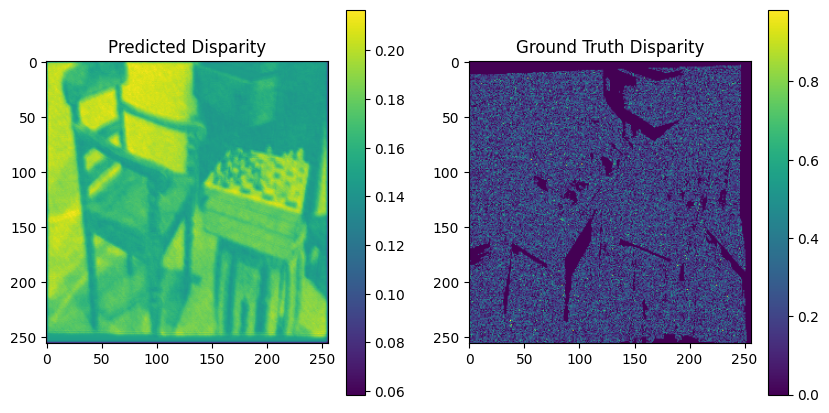

Predicted Disparity - Min: 0.05857440456748009, Max: 0.22692465782165527


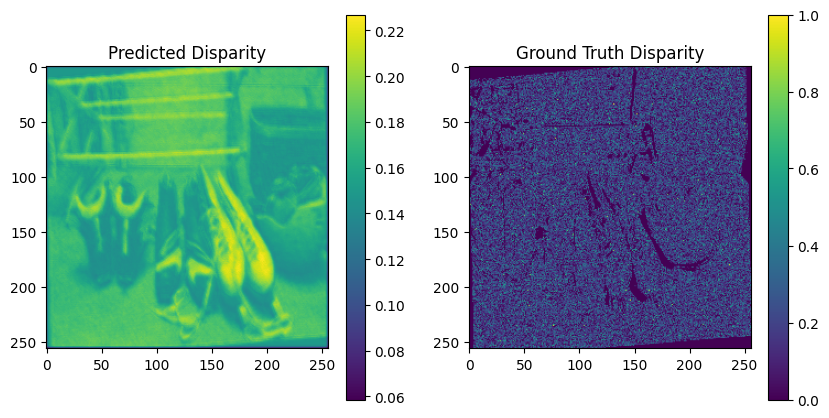

Predicted Disparity - Min: 0.058626722544431686, Max: 0.23327969014644623


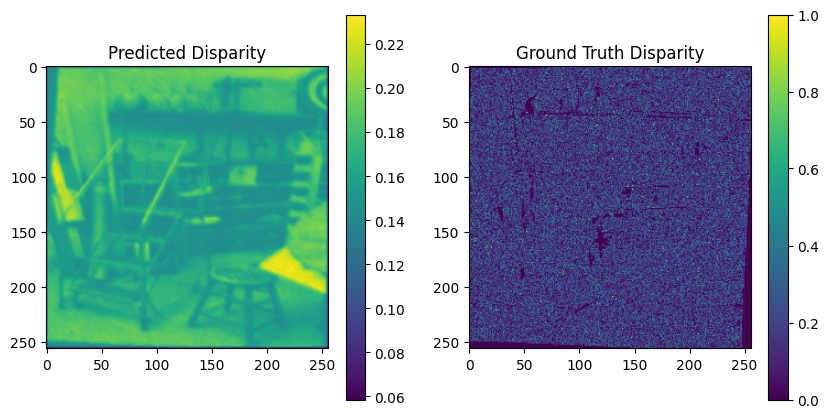

Epoch [16/25], Loss: 0.0078
Predicted Disparity - Min: 0.058690186589956284, Max: 0.2333686202764511


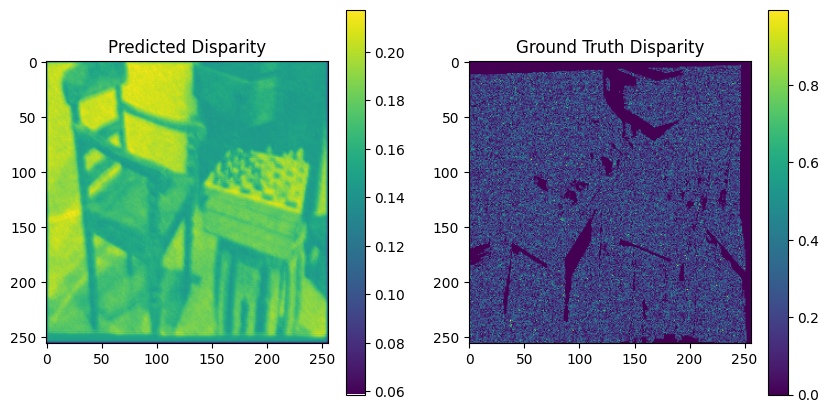

Predicted Disparity - Min: 0.0587589368224144, Max: 0.2214735597372055


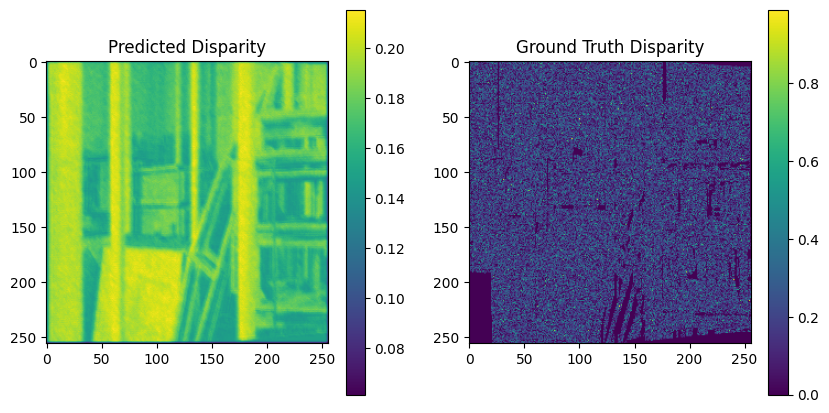

Predicted Disparity - Min: 0.05880958214402199, Max: 0.22710968554019928


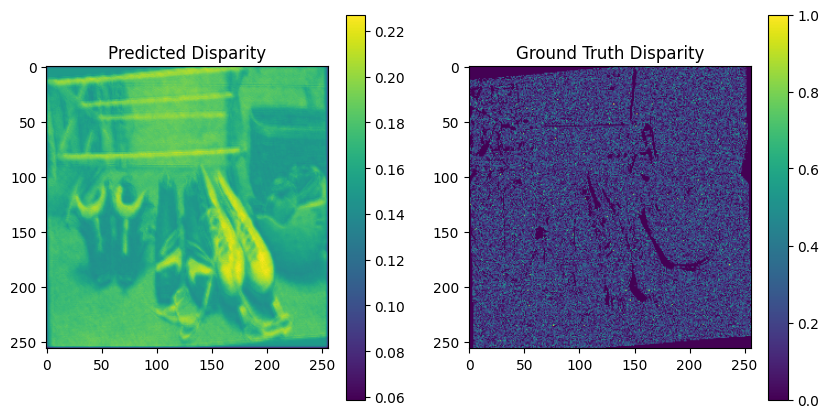

Epoch [17/25], Loss: 0.0082
Predicted Disparity - Min: 0.05884625390172005, Max: 0.22695550322532654


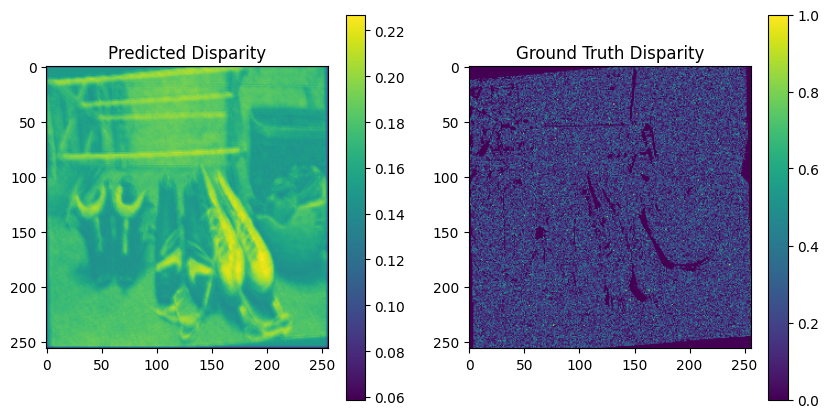

Predicted Disparity - Min: 0.05886765941977501, Max: 0.23295573890209198


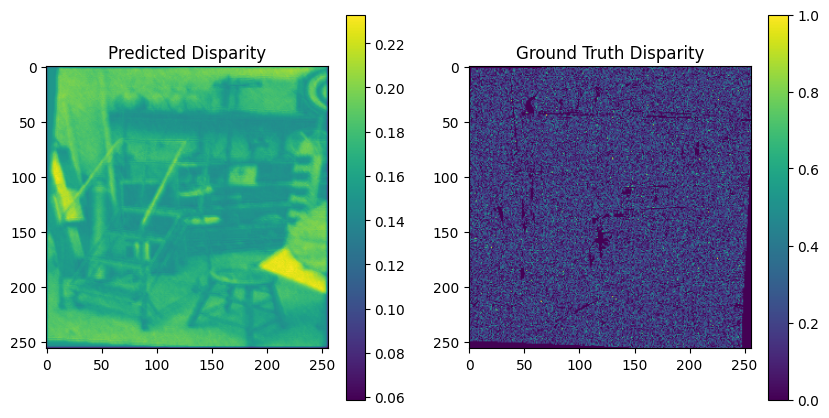

Predicted Disparity - Min: 0.06151435151696205, Max: 0.21497654914855957


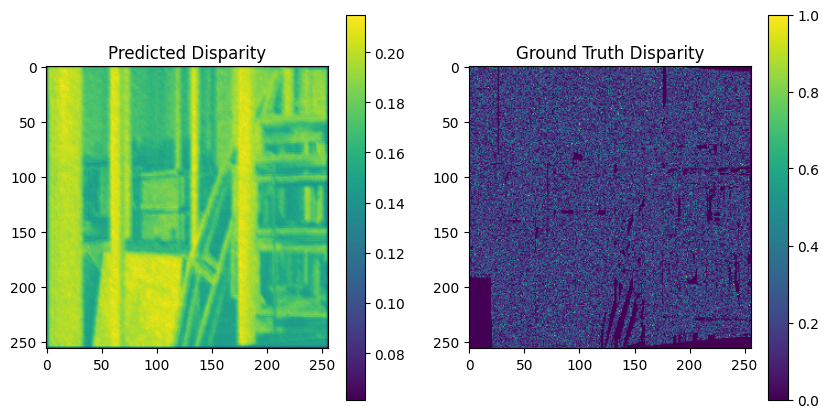

Epoch [18/25], Loss: 0.0083
Predicted Disparity - Min: 0.058916330337524414, Max: 0.22074903547763824


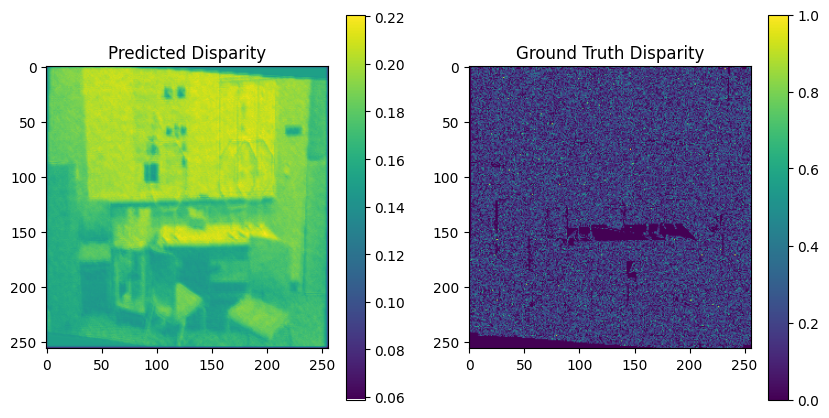

Predicted Disparity - Min: 0.05892815440893173, Max: 0.22550058364868164


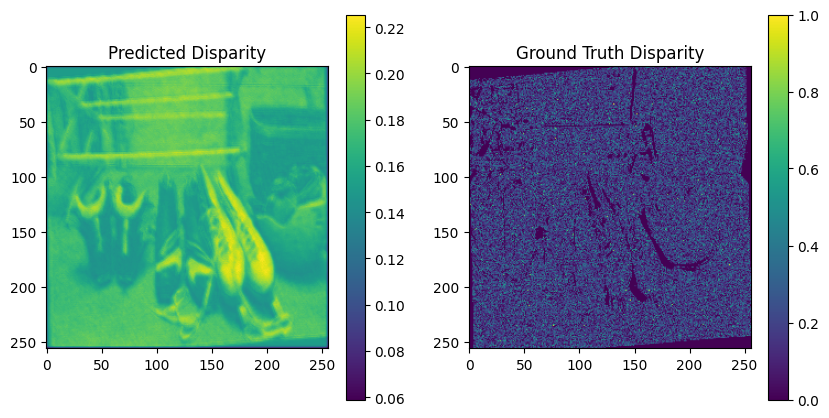

Predicted Disparity - Min: 0.0589282363653183, Max: 0.23123060166835785


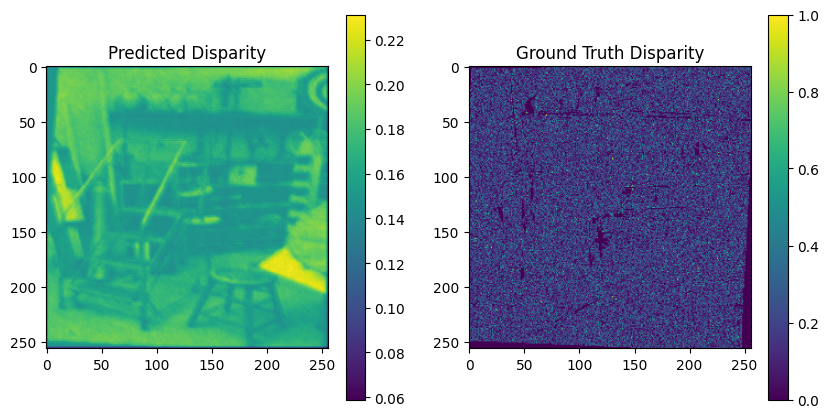

Epoch [19/25], Loss: 0.0078
Predicted Disparity - Min: 0.058944907039403915, Max: 0.2307068109512329


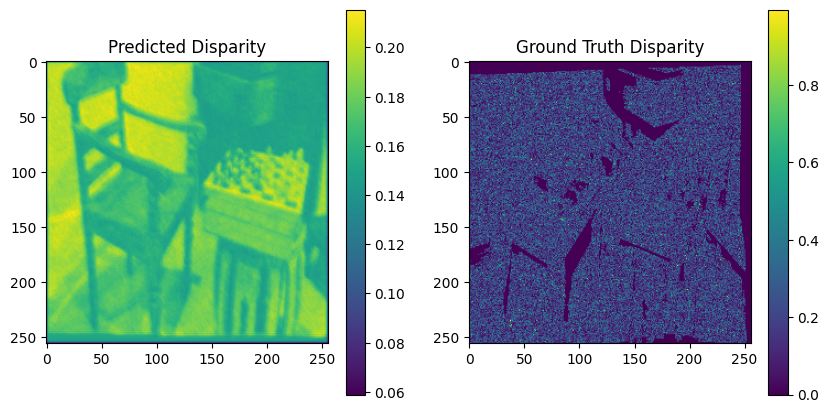

Predicted Disparity - Min: 0.05897241830825806, Max: 0.22398526966571808


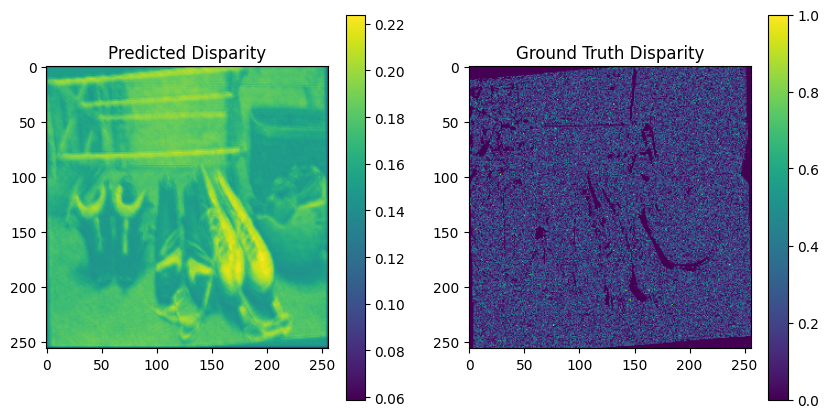

Predicted Disparity - Min: 0.0589861199259758, Max: 0.21857850253582


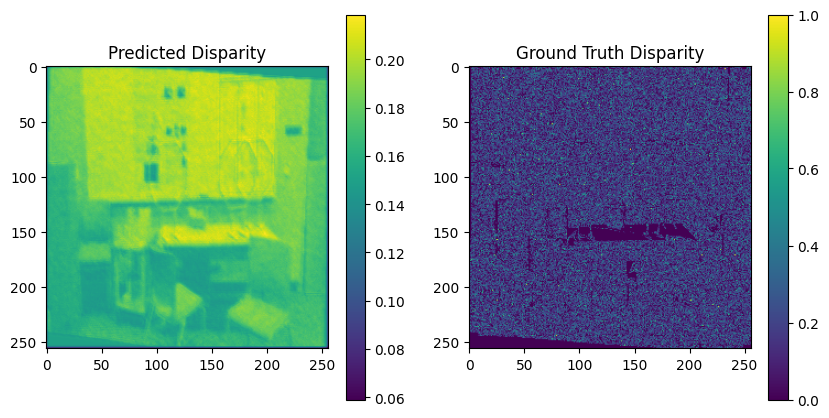

Epoch [20/25], Loss: 0.0078
Predicted Disparity - Min: 0.05898605287075043, Max: 0.21394871175289154


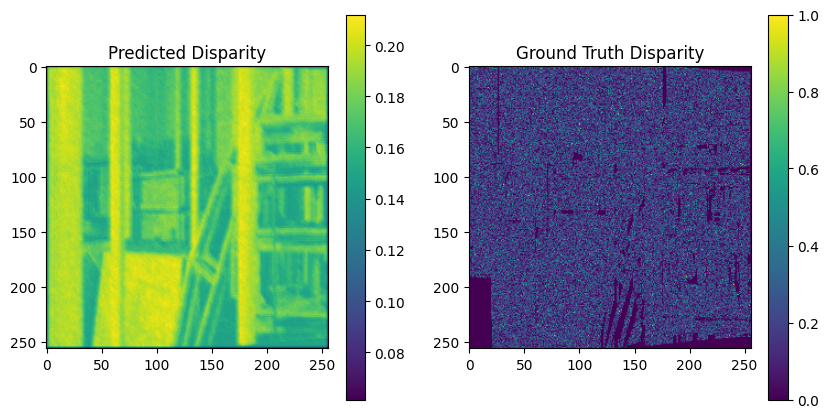

Predicted Disparity - Min: 0.05898597836494446, Max: 0.22859570384025574


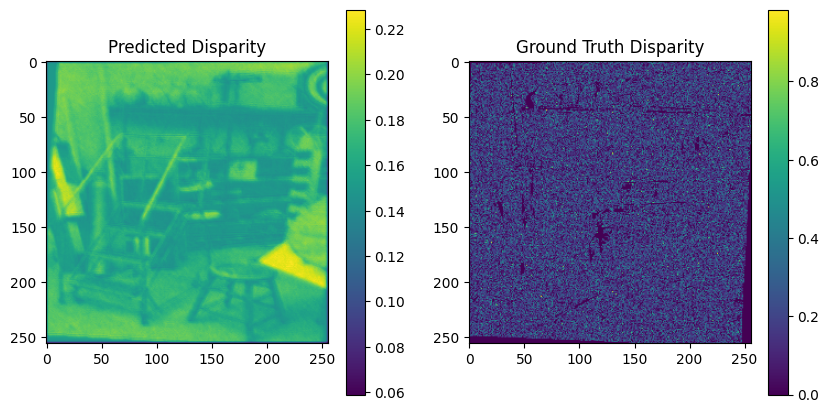

Predicted Disparity - Min: 0.05898655578494072, Max: 0.21732278168201447


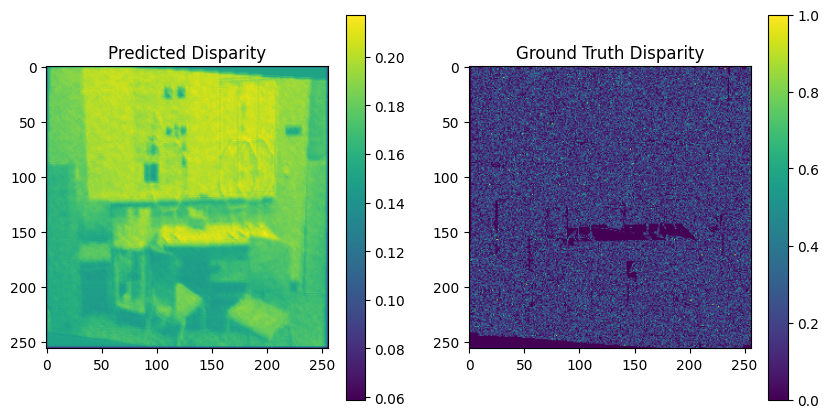

Epoch [21/25], Loss: 0.0078
Predicted Disparity - Min: 0.058981530368328094, Max: 0.2169511318206787


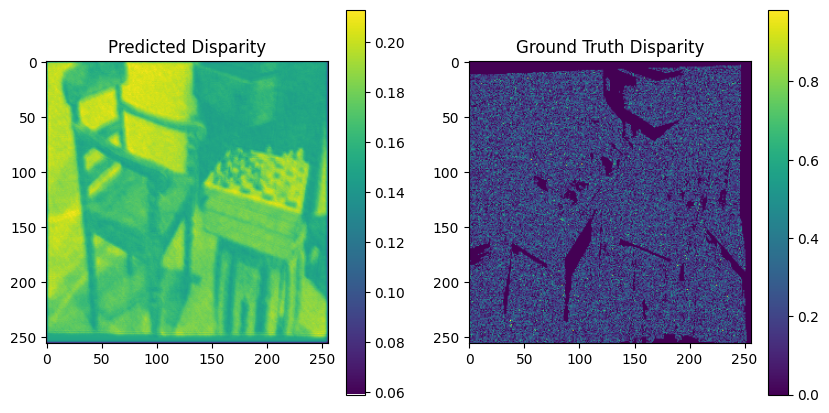

Predicted Disparity - Min: 0.05897512286901474, Max: 0.22740419209003448


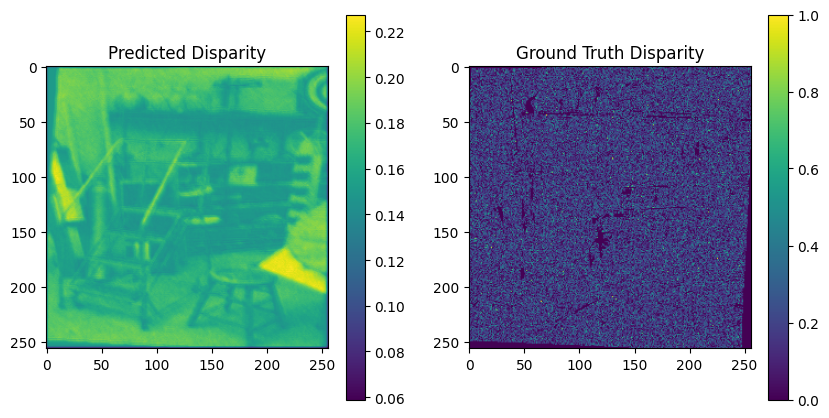

Predicted Disparity - Min: 0.05897226929664612, Max: 0.22093042731285095


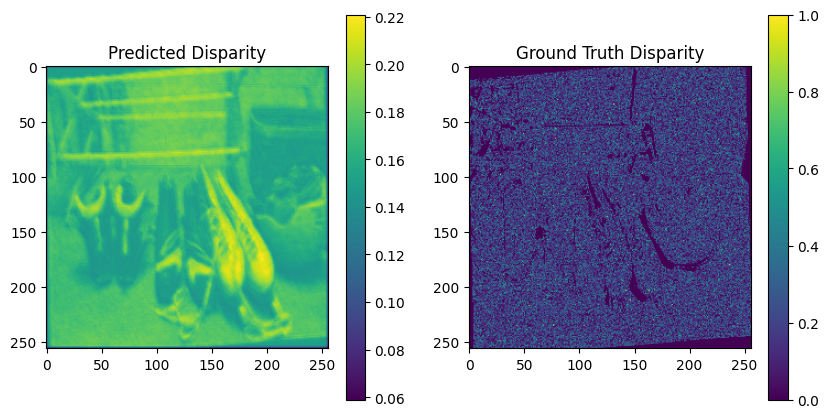

Epoch [22/25], Loss: 0.0082
Predicted Disparity - Min: 0.058965861797332764, Max: 0.21590711176395416


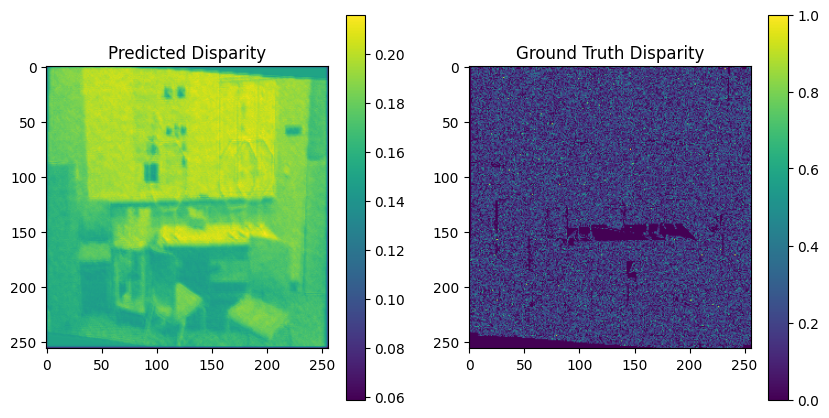

Predicted Disparity - Min: 0.058955118060112, Max: 0.2262076735496521


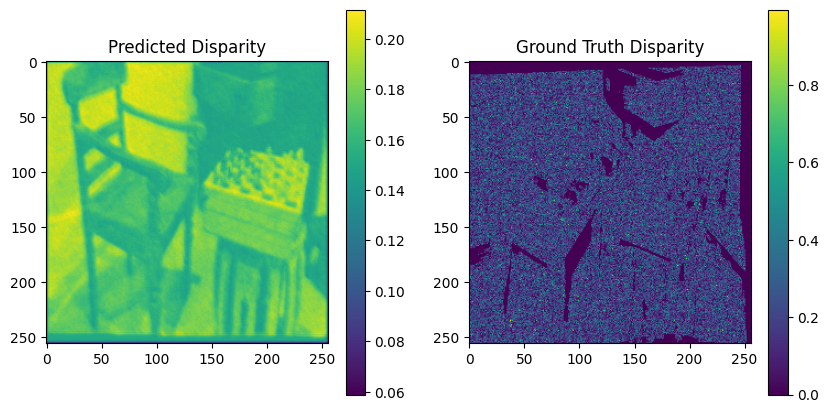

Predicted Disparity - Min: 0.05895223468542099, Max: 0.21985381841659546


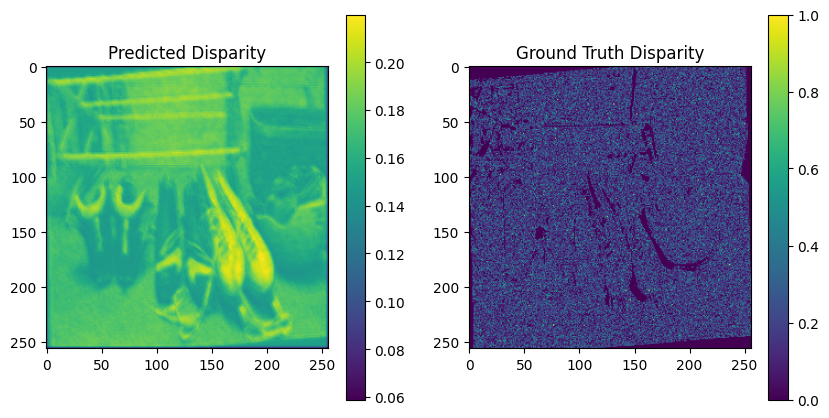

Epoch [23/25], Loss: 0.0082
Predicted Disparity - Min: 0.05894627794623375, Max: 0.22554758191108704


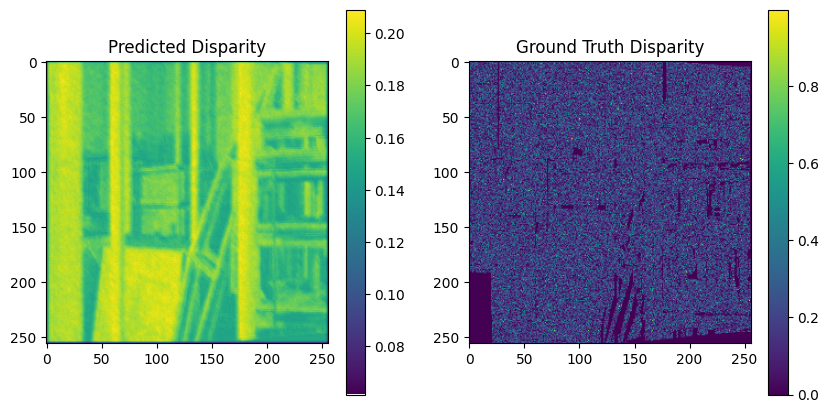

Predicted Disparity - Min: 0.05894434452056885, Max: 0.2193051129579544


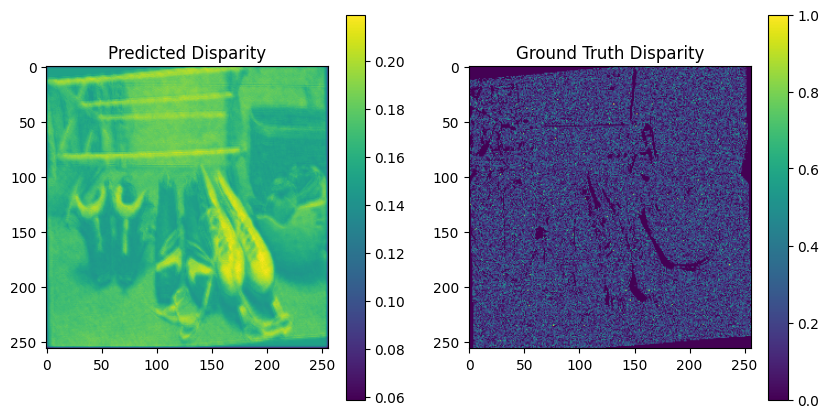

Predicted Disparity - Min: 0.05894192308187485, Max: 0.21491871774196625


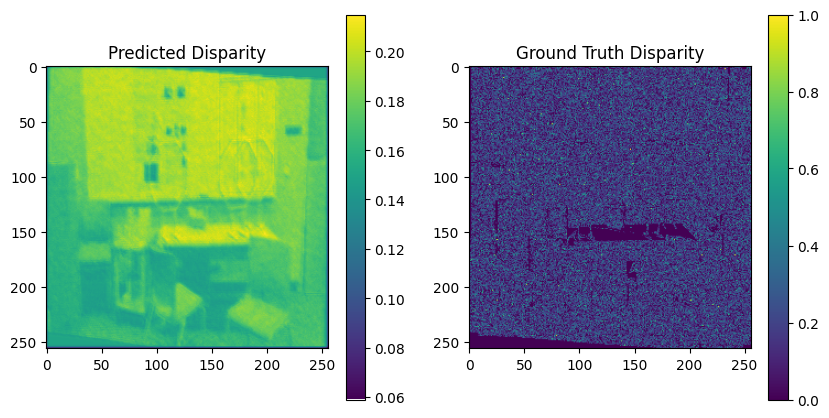

Epoch [24/25], Loss: 0.0078
Predicted Disparity - Min: 0.0589347742497921, Max: 0.2147139459848404


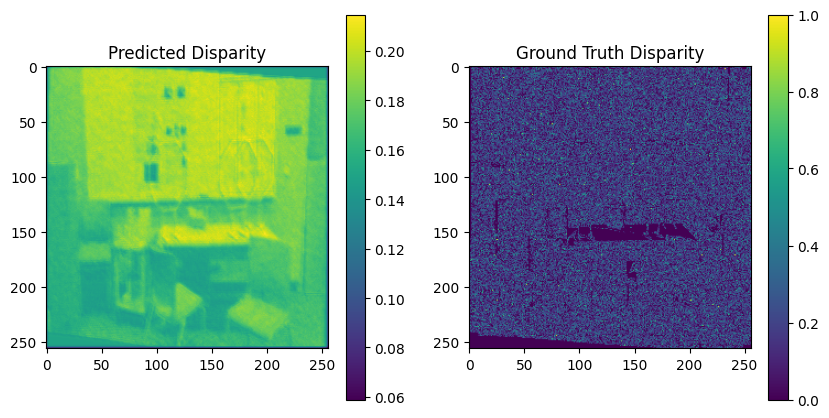

Predicted Disparity - Min: 0.058927271515131, Max: 0.22433383762836456


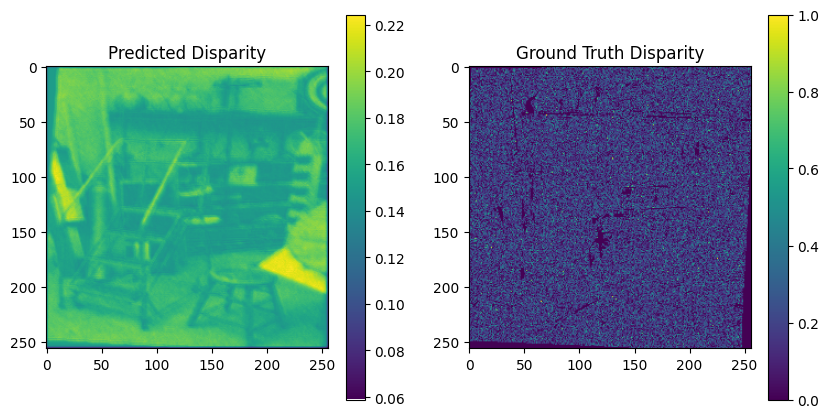

Predicted Disparity - Min: 0.058924350887537, Max: 0.21813882887363434


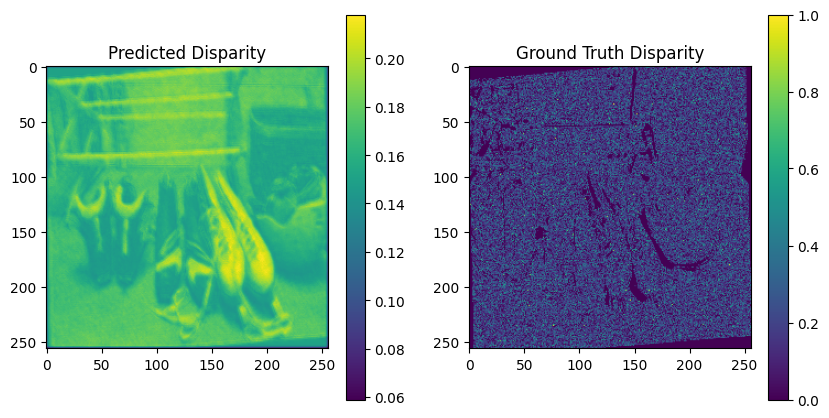

Epoch [25/25], Loss: 0.0082


In [ ]:
# Training loop
epochs = 25

# criterion = nn.MSELoss()
criterion = nn.SmoothL1Loss()

optimizer = optim.Adam(model.parameters(), lr=1e-4)

scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

for epoch in range(epochs):
    for idx, (left, right, disparity_target) in enumerate(dataloader):  # Unpack all three outputs
        # Move input images and target disparity to the GPU
        left, right, disparity_target = left, right, disparity_target

        disparity_target = (disparity_target - disparity_target.min()) / (disparity_target.max() - disparity_target.min())

        disparity_target[disparity_target < 0] = 0  # Mask invalid values

        # Forward pass
        disparity_pred = model(left, right)  # Predicted shape: (batch_size, 1, 256, 256)

        disparity_pred = torch.relu(disparity_pred)

        # Normalize the disparity for display
        disparity_pred_normalized = (disparity_pred - disparity_pred.min()) / (disparity_pred.max() - disparity_pred.min() + 1e-8)  # Avoid division by zero


        print(f"Predicted Disparity - Min: {disparity_pred.min().item()}, Max: {disparity_pred.max().item()}")

        # Resize target disparity to match the size of predicted disparity
        disparity_target_resized = F.interpolate(disparity_target.unsqueeze(1), size=(256, 256), mode='bilinear', align_corners=False)

        # Compute loss
        loss = criterion(disparity_pred, disparity_target_resized)

        plt.figure(figsize=(10, 5))

        # Predicted Disparity
        plt.subplot(1, 2, 1)
        plt.imshow(disparity_pred[0].squeeze().detach().cpu().numpy(), cmap='viridis')
        plt.title("Predicted Disparity")
        plt.colorbar()

        # Ground Truth Disparity
        plt.subplot(1, 2, 2)
        plt.imshow(disparity_target_resized[0].squeeze().cpu().numpy(), cmap='viridis')
        plt.title("Ground Truth Disparity")
        plt.colorbar()

        plt.show()


        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()



    # Step the scheduler
    scheduler.step()

    # Log progress
    current_lr = optimizer.param_groups[0]['lr']
    print(f"Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}")



Test and evaluate the model

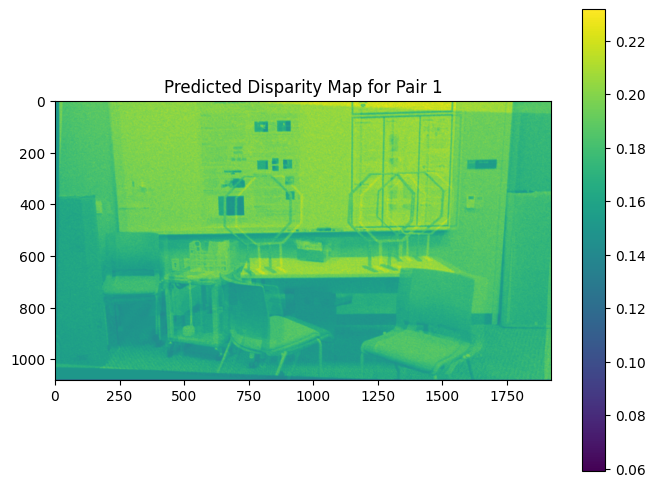

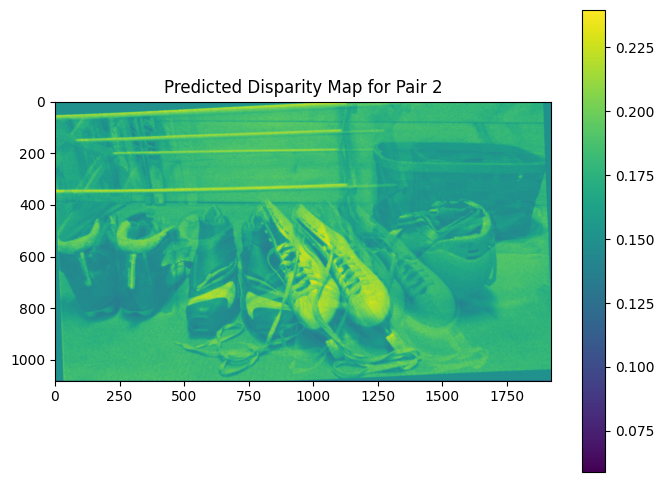

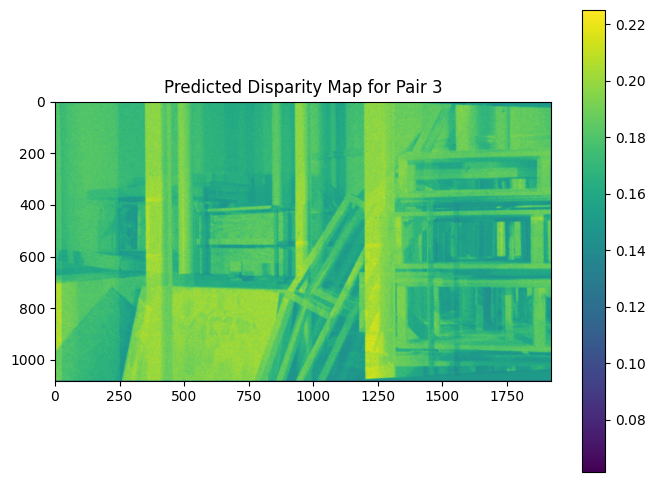

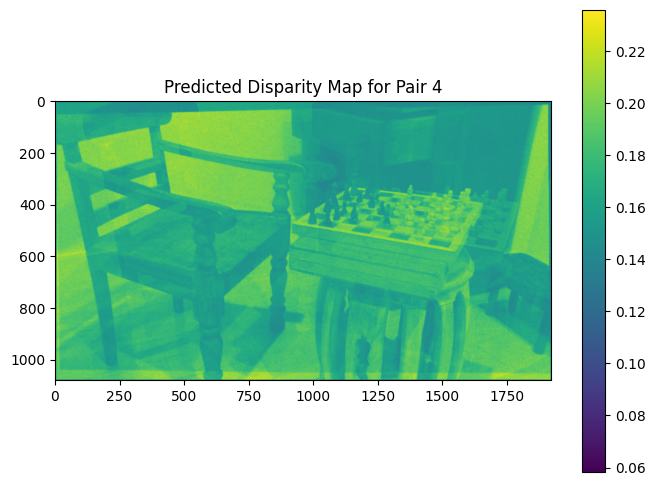

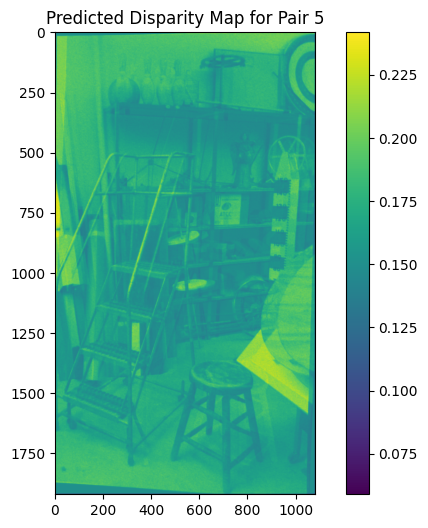

In [ ]:
model.eval()

dList = []

for idx, (left_image, right_image) in enumerate(zip(lowlightDisplayLeftList, lowlightDisplayRightList)):
    with torch.no_grad():

        test_left = torch.from_numpy(left_image.transpose(2, 0, 1)).unsqueeze(0).float()
        test_right = torch.from_numpy(right_image.transpose(2, 0, 1)).unsqueeze(0).float()

        disparity_map = model(test_left, test_right).squeeze(0).cpu().numpy()

        dList.append(disparity_map)

    plt.figure(figsize=(8, 6))
    plt.imshow(disparity_map[0])
    plt.title(f"Predicted Disparity Map for Pair {idx + 1}")
    plt.colorbar()
    plt.show()


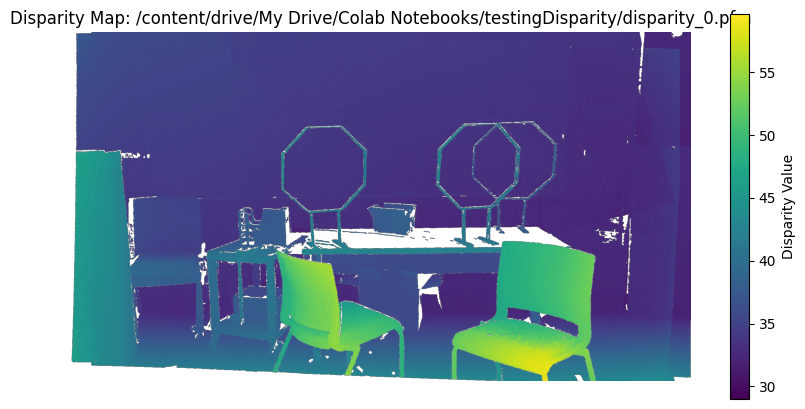

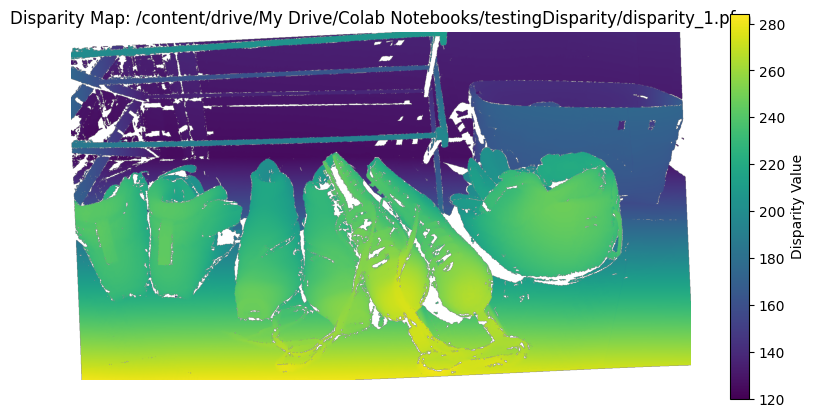

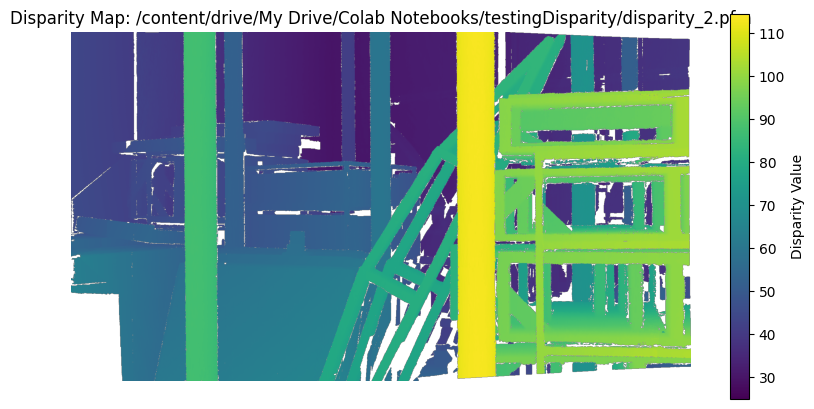

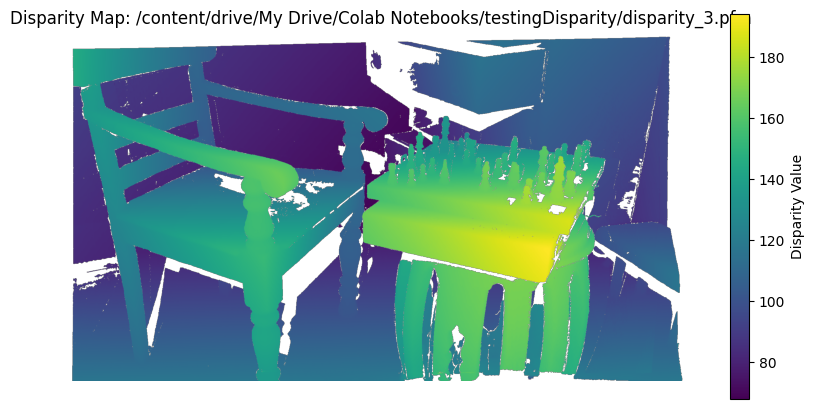

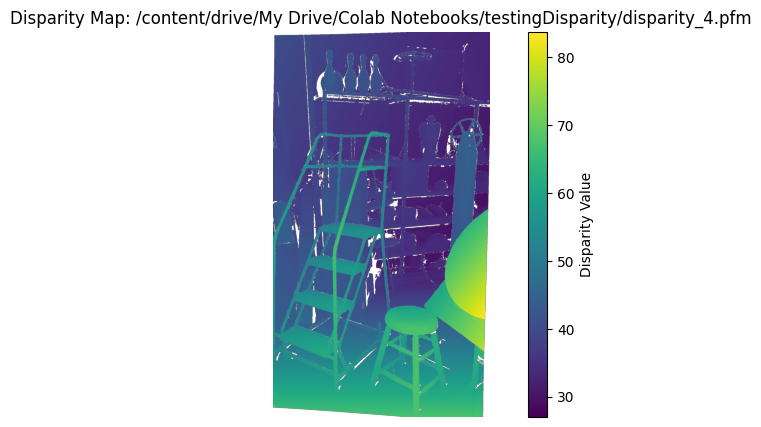

In [ ]:
for disparity_file in trainingDisparity:
    disparity_map, scale = read_pfm(disparity_file)  # Read the disparity map

    # Flip the disparity map vertically
    disparity_map = np.flipud(disparity_map)

    # Display the corrected disparity map
    plt.figure(figsize=(10, 5))
    plt.imshow(disparity_map, cmap='viridis')  # Use a colormap for better visualization
    plt.title(f"Disparity Map: {disparity_file}")
    plt.colorbar(label="Disparity Value")
    plt.axis('off')
    plt.show()

In [ ]:
# Initialize a list to store RMSE values
rmse_values = []

# Loop through all disparity pairs
for newDisparity, oldDisparity in zip(dList, lowlightDisparityList):
    # Squeeze newDisparity to match the shape of oldDisparity
    newDisparity_squeezed = np.squeeze(newDisparity)  # Shape becomes (1080, 1920)

    # Compute RMSE for the pair and add to the list
    rmse_value = rmse(newDisparity_squeezed, oldDisparity)
    rmse_values.append(rmse_value)

    # Optionally, print the RMSE for each pair
    print(f"RMSE for current pair: {rmse_value}")

# Calculate the average RMSE
average_rmse = np.mean(rmse_values)
print(f"Stereo Average RMSE for training set: {average_rmse}")


RMSE for current pair: 0.1744485869813935
RMSE for current pair: 0.1681130984931831
RMSE for current pair: 0.1713473331831186
RMSE for current pair: 0.16843939867119012
RMSE for current pair: 0.1632476366142105
Stereo Average RMSE for training set: 0.1691192107886192


save the model

In [ ]:
torch.save(model.state_dict(), "stereo_cnn_model.pth")

Now apply everything we've done up till now to the official test images we were given.

In [ ]:
model = StereoCNN()
model.load_state_dict(torch.load("stereo_cnn_model.pth"))
model.eval()

<ipython-input-43-e6e5d75c34ff>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("stereo_cnn_model.pth"))


StereoCNN(
  (encoder): Sequential(
    (0): Conv2d(6, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
  )
  (decoder): Sequential(
    (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  )
)

Load Dataset

In [ ]:
officialDataset = StereoDataset(displayLeftList, displayRightList, disparityList)
officialDataloader = DataLoader(officialDataset, batch_size=2, shuffle=True)

Perform inference

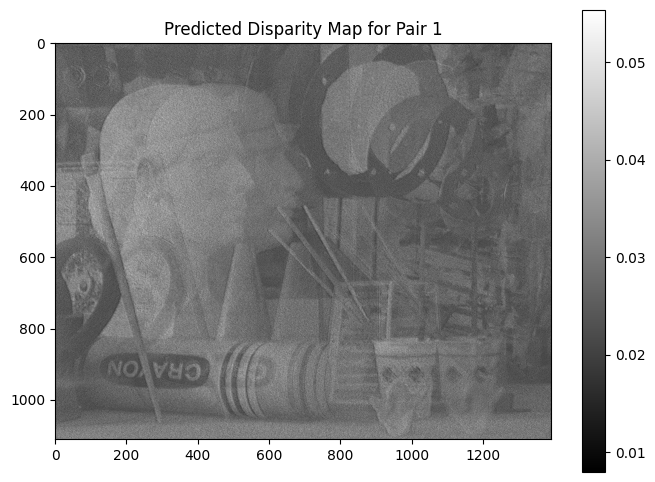

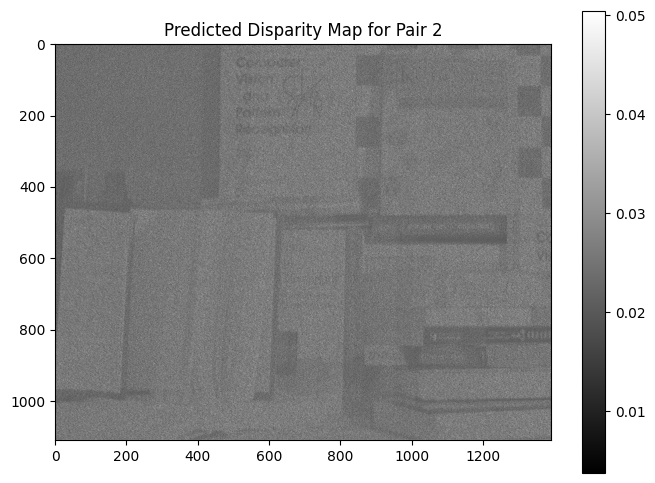

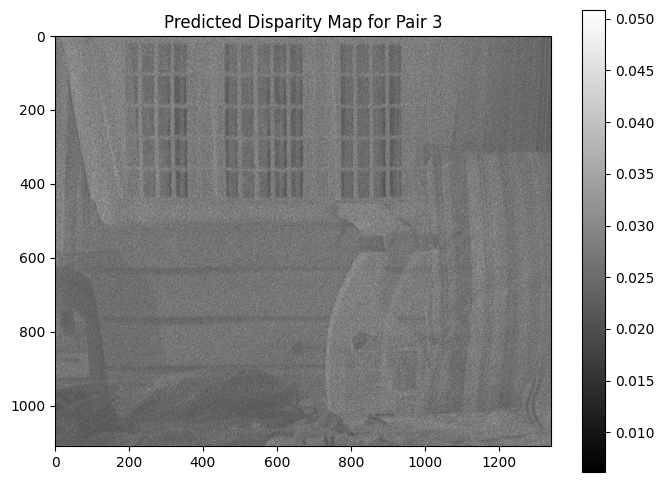

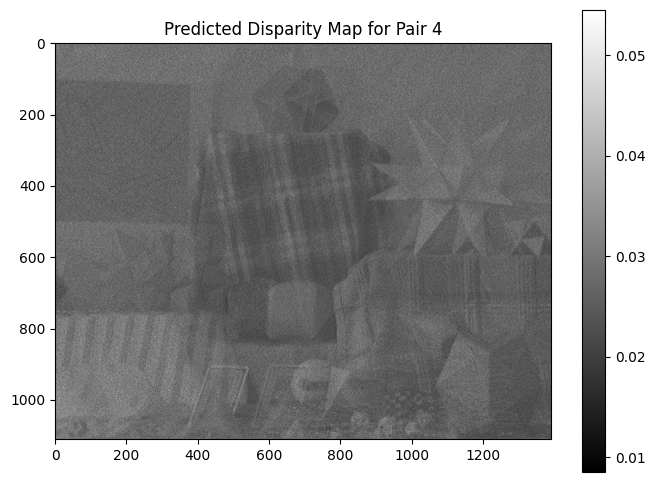

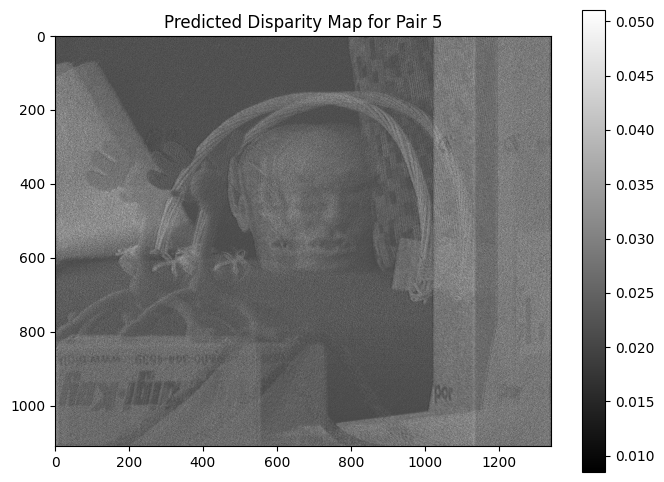

In [ ]:
finalDList = []

for idx, (left_image, right_image) in enumerate(zip(displayLeftList, displayRightList)):
    with torch.no_grad():

        test_left = torch.from_numpy(left_image.transpose(2, 0, 1)).unsqueeze(0).float()
        test_right = torch.from_numpy(right_image.transpose(2, 0, 1)).unsqueeze(0).float()

        disparity_map = model(test_left, test_right).squeeze(0).cpu().numpy()

        finalDList.append(disparity_map)

    plt.figure(figsize=(8, 6))
    plt.imshow(disparity_map[0], cmap='gray')
    plt.title(f"Predicted Disparity Map for Pair {idx + 1}")
    plt.colorbar()
    plt.show()

evaluate the rmse value

In [ ]:
# Initialize a list to store RMSE values
rmse_values = []

for newDisparity, oldDisparity in zip(finalDList, disparityList):
    # Squeeze newDisparity to remove extra dimensions
    newDisparity_squeezed = np.squeeze(newDisparity)

    # Convert oldDisparity to a supported type
    if oldDisparity.dtype == np.float64:  # Check if it's float64
        oldDisparity = oldDisparity.astype(np.float32)

    # Convert to grayscale if needed
    if oldDisparity.ndim == 3:  # Check if it's a 3D array
        oldDisparity = cv2.cvtColor(oldDisparity, cv2.COLOR_BGR2GRAY)

    # Ensure dimensions match
    # print(f"newDisparity shape: {newDisparity_squeezed.shape}, oldDisparity shape: {oldDisparity.shape}")

    # Compute RMSE for the current pair
    rmse_value = rmse(newDisparity_squeezed, oldDisparity)
    rmse_values.append(rmse_value)
    print(f"RMSE for current pair: {rmse_value}")

# Calculate the average RMSE
average_rmse = np.mean(rmse_values)
print(f"StereonCNN Average RMSE for the final test set: {average_rmse}")


RMSE for current pair: 0.5216289497022883
RMSE for current pair: 0.5102982661379989
RMSE for current pair: 0.47260941216036917
RMSE for current pair: 0.4311280458145649
RMSE for current pair: 0.4958752249862629
StereonCNN Average RMSE for the final test set: 0.4863079797602968
